# Projet 2 : Préparez des données pour un organisme de santé publique (NB 2: Exploration)
  <!-- AUTHOR : Anthony DAVID -->

**Mission :** L'agence Santé publique France souhaite améliorer sa base de données Open Food Facts en prédisant les valeurs manquantes. Notre mission sera de nettoyer et explorer les données puis de prédire les valeurs manquantes et de réaliser des visualisations en vu d'une présentation finale.

**Jeu de données :** Le jeu de données Open Food Facts est disponible sur le [site officiel](https://world.openfoodfacts.org/) (ou disponible à [ce lien](https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/parcours-data-scientist/P2/fr.openfoodfacts.org.products.csv.zip) en téléchargement). Les variables sont définies à [cette adresse](https://world.openfoodfacts.org/data/data-fields.txt). Les champs sont séparés en quatre sections :
- Les informations générales sur la fiche du produit : nom, date de modification, etc.
- Un ensemble de tags : catégorie du produit, localisation, origine, etc.
- Les ingrédients composant les produits et leurs additifs éventuels.
- Des informations nutritionnelles : quantité en grammes d’un nutriment pour 100 grammes du produit.

In [128]:
# %matplotlib widget
import pandas as pd
import missingno as msno
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from sklearn.impute import KNNImputer
import numpy as np
from sklearn.decomposition import PCA
from mlxtend.plotting import plot_pca_correlation_graph
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import StandardScaler
import pingouin as pg
import scipy.stats as stats
import math

In [3]:
df_original = pd.read_csv("P2_data.csv", low_memory=False, delimiter='\t')
df_relevant = pd.read_csv("P2_data_relevant.csv", low_memory=False)
df_calculation = pd.read_csv("P2_data_cleaned_by_calculation.csv", low_memory=False)
df_cleaned = pd.read_csv("P2_data_cleaned_auto.csv", low_memory=False)

In [44]:
df_calculation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156068 entries, 0 to 156067
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   code                     156068 non-null  object 
 1   created_t                156068 non-null  object 
 2   product_name             154099 non-null  object 
 3   countries_fr             156050 non-null  object 
 4   ingredients_text         150446 non-null  object 
 5   nutrition_grade_fr       156068 non-null  object 
 6   energy_100g              156068 non-null  float64
 7   fat_100g                 156068 non-null  float64
 8   saturated_fat_100g       156068 non-null  float64
 9   carbohydrates_100g       156068 non-null  float64
 10  sugars_100g              156068 non-null  float64
 11  fiber_100g               156068 non-null  float64
 12  proteins_100g            156068 non-null  float64
 13  salt_100g                156068 non-null  float64
 14  sodi

In [45]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260756 entries, 0 to 260755
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   code                     260756 non-null  object 
 1   created_t                260756 non-null  object 
 2   product_name             257421 non-null  object 
 3   countries_fr             260687 non-null  object 
 4   ingredients_text         233949 non-null  object 
 5   nutrition_grade_fr       260756 non-null  object 
 6   energy_100g              260756 non-null  float64
 7   fat_100g                 260756 non-null  float64
 8   saturated_fat_100g       260756 non-null  float64
 9   carbohydrates_100g       260756 non-null  float64
 10  sugars_100g              260756 non-null  float64
 11  fiber_100g               260756 non-null  float64
 12  proteins_100g            260756 non-null  float64
 13  salt_100g                260756 non-null  float64
 14  sodi

## Analyse univariée

L'analyse univariée a pour but de décrire et mesurer la répartition des valeurs que peut prendre une variable. 

<Axes: >

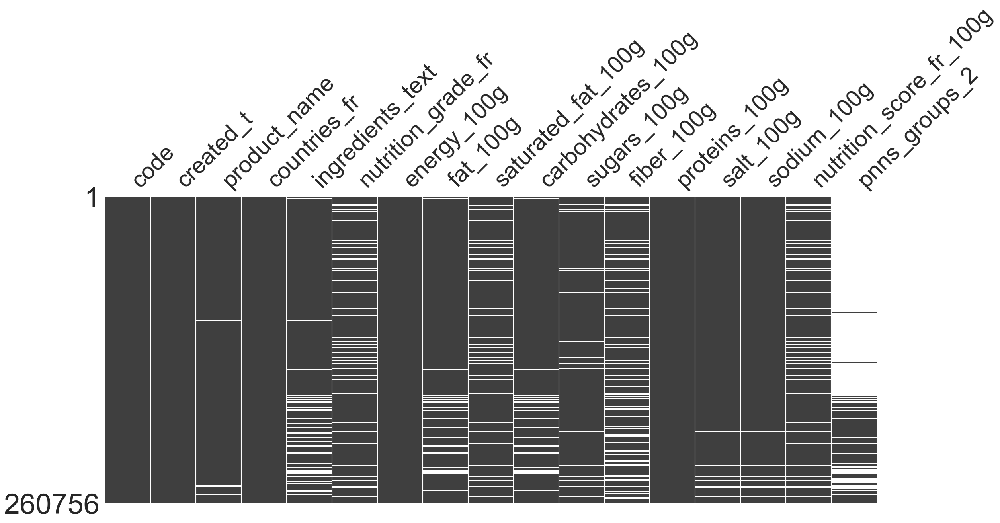

In [63]:
msno.matrix(df_relevant, fontsize=42, sparkline=False)

<Axes: >

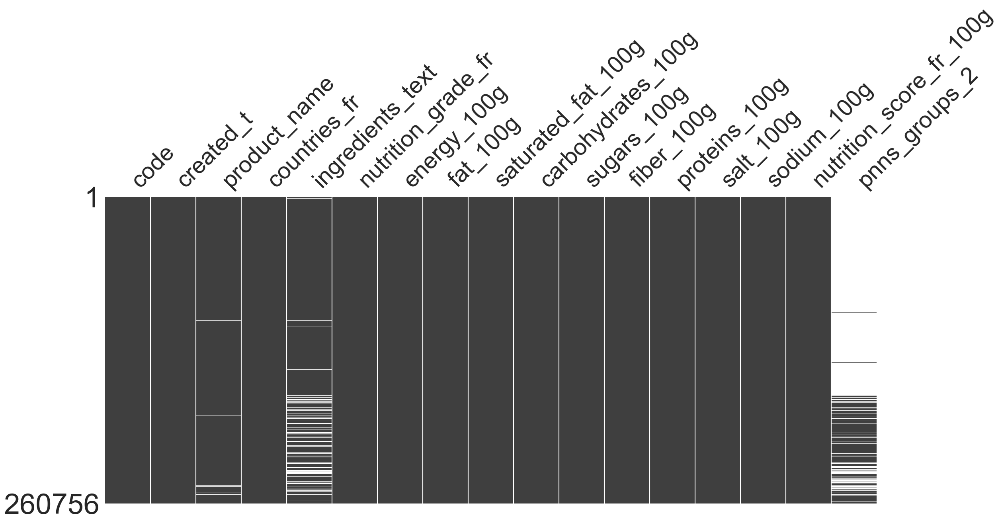

In [64]:
msno.matrix(df_cleaned, fontsize=42, sparkline=False)

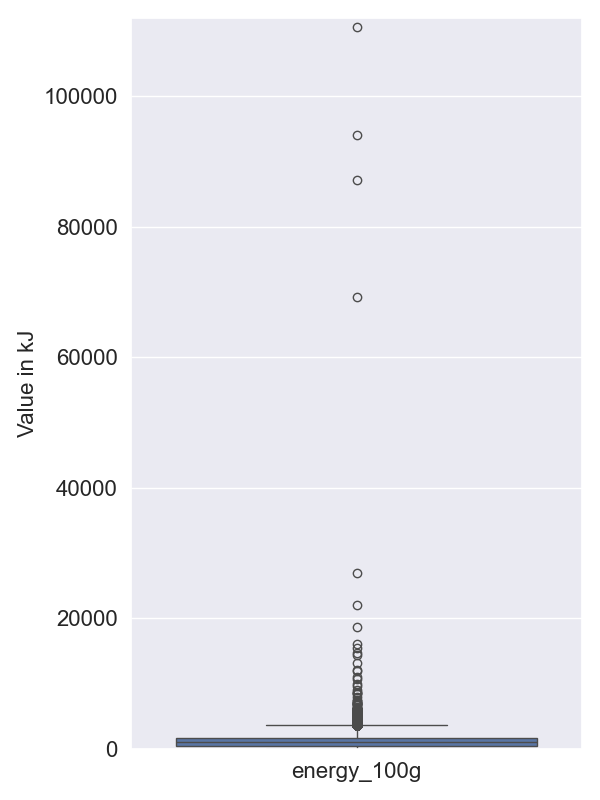

In [142]:
# Select the relevant column
selected_columns = ['energy_100g']

# Create a new DataFrame with only the selected columns
df_selected = df_original[selected_columns]

# Plot the boxplot
plt.figure(figsize=(6, 8))
# plt.figure()
sns.boxplot(data=df_selected)
# plt.title('Boxplot of Nutritional Values')
plt.ylabel('Value in kJ')
# plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility

# Set y-axis limits
plt.ylim(-10, 1.12e5)

plt.tight_layout()

plt.show()

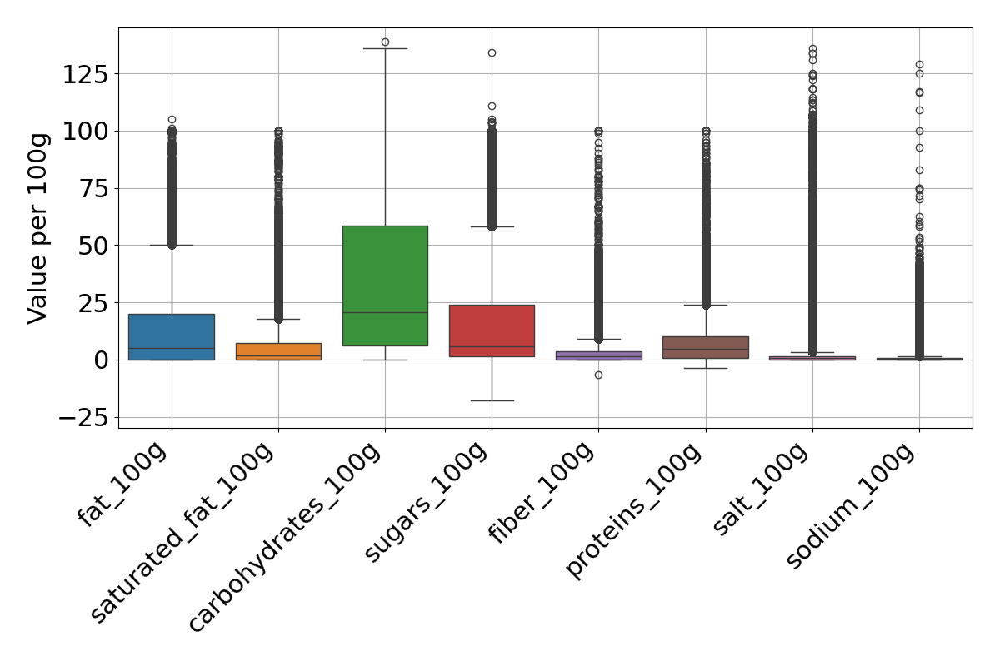

In [165]:
# Select the relevant columns
selected_columns = ['fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 'sugars_100g',
                    'fiber_100g', 'proteins_100g', 'salt_100g', 'sodium_100g']

# Create a new DataFrame with only the selected columns
df_selected = df_relevant[selected_columns]

# Plot the boxplot
plt.figure(figsize=(12, 8))
plt.rcParams.update({'font.size': 22})

sns.boxplot(data=df_selected)
# plt.title('Boxplot of Nutritional Values')
plt.ylabel('Value per 100g')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility

# plt.grid(axis='y', linestyle='--')
plt.grid(True)
# Set y-axis limits
plt.ylim(-30, 145)

plt.tight_layout()

plt.show()

# Reset font.size to its default value
plt.rcParams.update(plt.rcParamsDefault)

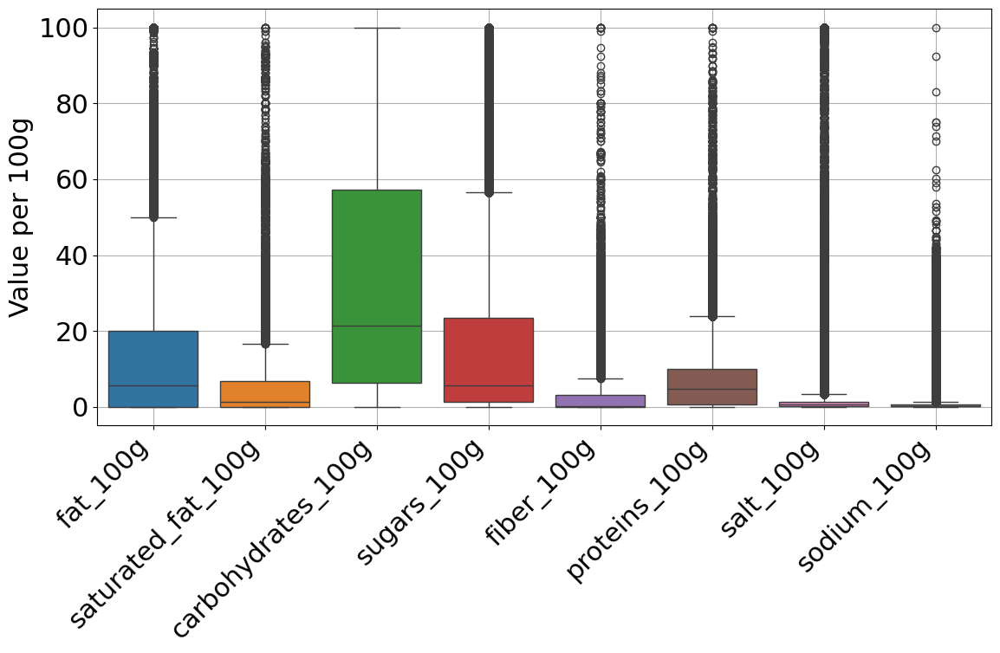

In [5]:
# Select the relevant columns
selected_columns = ['fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 'sugars_100g',
                    'fiber_100g', 'proteins_100g', 'salt_100g', 'sodium_100g']

# Create a new DataFrame with only the selected columns
df_selected = df_cleaned[selected_columns]

# Plot the boxplot
plt.figure(figsize=(12, 8))
plt.rcParams.update({'font.size': 22})

sns.boxplot(data=df_selected)
# plt.title('Boxplot of Nutritional Values')
plt.ylabel('Value per 100g')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility

# plt.grid(axis='y', linestyle='--')
plt.grid(True)

# Set y-axis limits
# plt.ylim(-30, 145)

plt.tight_layout()

plt.show()

# Reset font.size to its default value
plt.rcParams.update(plt.rcParamsDefault)

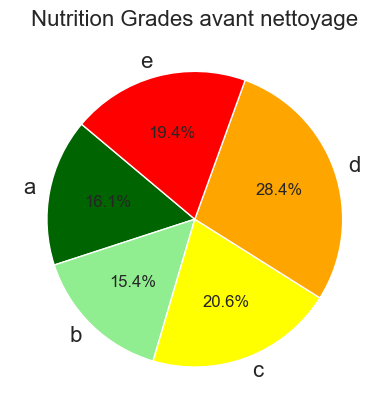

In [66]:
# Order of nutrigrades
desired_order = ['a', 'b', 'c', 'd', 'e']

# Create a custom ordering for the nutrigrades
grades_counts = df_relevant['nutrition_grade_fr'].value_counts().reindex(desired_order)

# Assigning colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}

# Plotting a pie chart
plt.pie(grades_counts, labels=grades_counts.index, colors=[colors[grade] for grade in grades_counts.index],
        autopct='%1.1f%%', startangle=140)
plt.title('Nutrition Grades avant nettoyage')
plt.show()

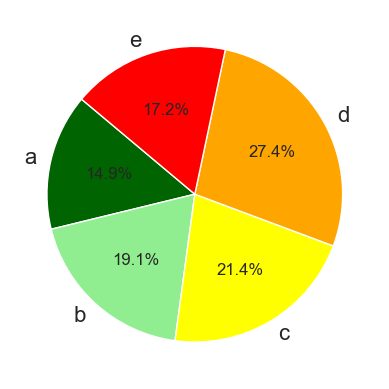

In [67]:
# Order of nutrigrades
desired_order = ['a', 'b', 'c', 'd', 'e']

# Create a custom ordering for the nutrigrades
grades_counts = df_cleaned['nutrition_grade_fr'].value_counts().reindex(desired_order)

# Assigning colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}

# Plotting a pie chart
plt.pie(grades_counts, labels=grades_counts.index, colors=[colors[grade] for grade in grades_counts.index],
        autopct='%1.1f%%', startangle=140)
# plt.title('Nutrition Grades après nettoyage')
plt.show()

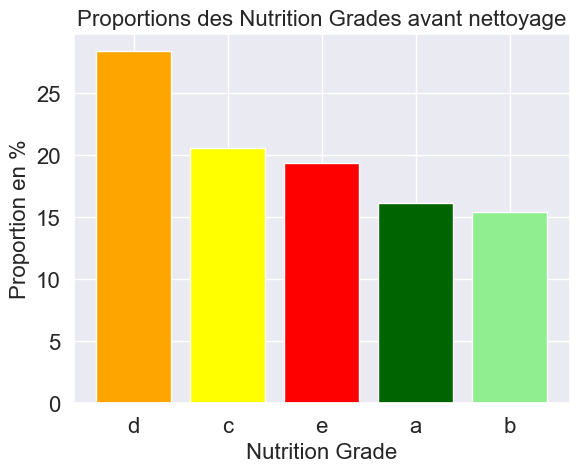

In [68]:
# Get the counts of each nutrition grade
grades_counts = df_relevant['nutrition_grade_fr'].value_counts()

# Calculate proportions
total_samples = len(df_relevant['nutrition_grade_fr'].dropna())
proportions = grades_counts / total_samples * 100

# Assigning colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}

# Plotting a bar chart with proportions
plt.bar(proportions.index, proportions, color=[colors[grade] for grade in proportions.index])
plt.title('Proportions des Nutrition Grades avant nettoyage')
plt.xlabel('Nutrition Grade')
plt.ylabel('Proportion en %')
plt.show()

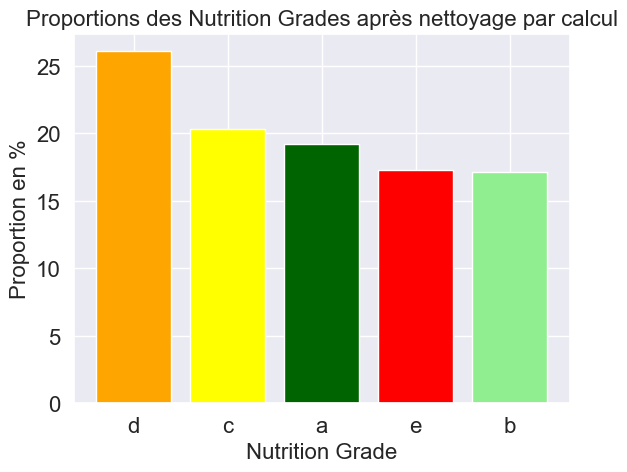

In [69]:
# Get the counts of each nutrition grade
grades_counts = df_calculation['nutrition_grade_fr'].value_counts()

# Calculate proportions
total_samples = len(df_calculation['nutrition_grade_fr'].dropna())
proportions = grades_counts / total_samples * 100

# Assigning colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}

# Plotting a bar chart with proportions
plt.bar(proportions.index, proportions, color=[colors[grade] for grade in proportions.index])
plt.title('Proportions des Nutrition Grades après nettoyage par calcul')
plt.xlabel('Nutrition Grade')
plt.ylabel('Proportion en %')
plt.show()

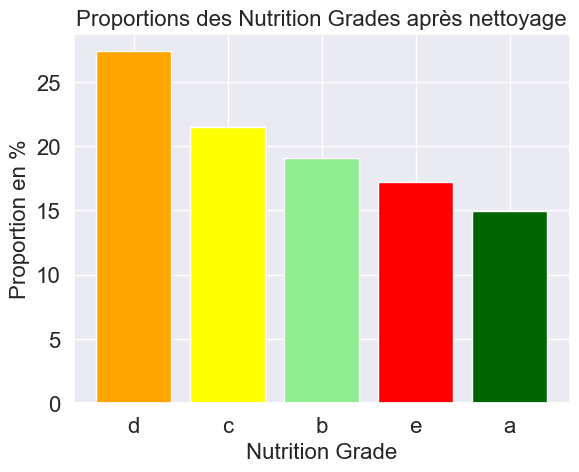

In [70]:
# Get the counts of each nutrition grade
grades_counts = df_cleaned['nutrition_grade_fr'].value_counts()

# Calculate proportions
total_samples = len(df_cleaned['nutrition_grade_fr'].dropna())
proportions = grades_counts / total_samples * 100

# Assigning colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}

# Plotting a bar chart with proportions
plt.bar(proportions.index, proportions, color=[colors[grade] for grade in proportions.index])
plt.title('Proportions des Nutrition Grades après nettoyage')
plt.xlabel('Nutrition Grade')
plt.ylabel('Proportion en %')
plt.show()

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_96088/2526459514.py:19: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



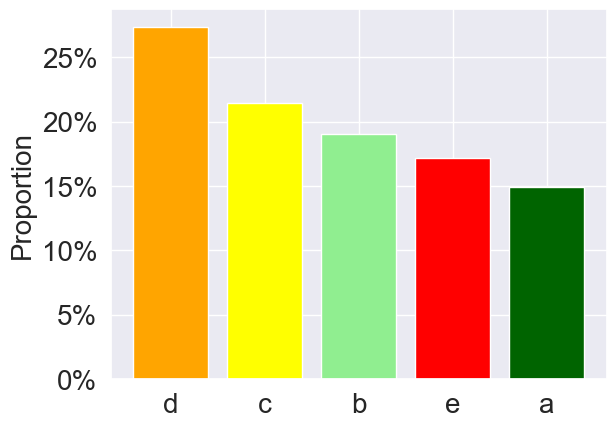

In [71]:
# Get the counts of each nutrition grade, excluding NaN values
grades_counts = df_cleaned['nutrition_grade_fr'].value_counts()

# Calculate total samples excluding NaN values
total_samples = len(df_cleaned['nutrition_grade_fr'].dropna())

# Calculate proportions
proportions = grades_counts / total_samples * 100

# Assigning colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}

# Plotting a bar chart with proportions
plt.bar(proportions.index, proportions, color=[colors[grade] for grade in proportions.index])
# plt.title('Proportions des Nutrition Grades après nettoyage', fontsize=30)
plt.ylabel('Proportion', fontsize=20)
plt.xticks(fontsize=20)  # Adjust x-axis tick label fontsize
plt.yticks(fontsize=20)  # Adjust y-axis tick label fontsize
plt.gca().set_yticklabels(['{}%'.format(int(x)) for x in plt.gca().get_yticks()])

plt.show()

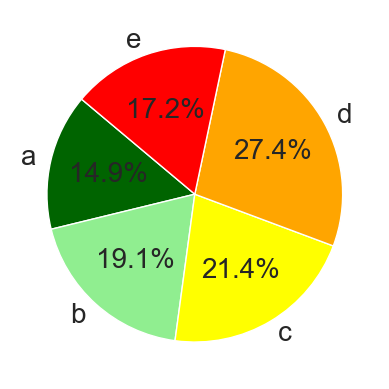

In [72]:
# Order of nutrigrades
desired_order = ['a', 'b', 'c', 'd', 'e']

# Create a custom ordering for the nutrigrades
grades_counts = df_cleaned['nutrition_grade_fr'].value_counts().reindex(desired_order)

# Assigning colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}

# Plotting a pie chart with proportions
plt.pie(grades_counts, labels=grades_counts.index, colors=[colors[grade] for grade in grades_counts.index],
        autopct='%1.1f%%', startangle=140, textprops={'fontsize': 20})
# plt.title('Nutrition Grades après nettoyage', fontsize=20)
plt.show()

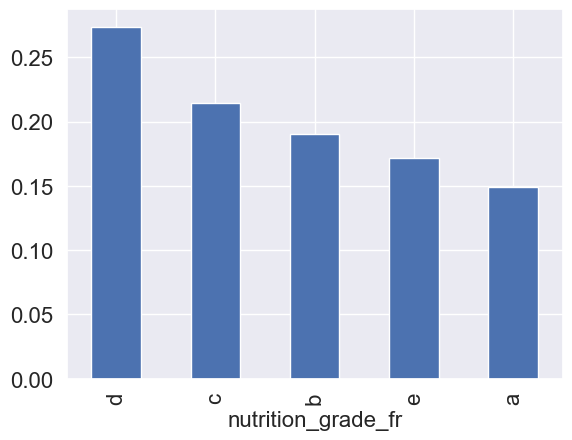

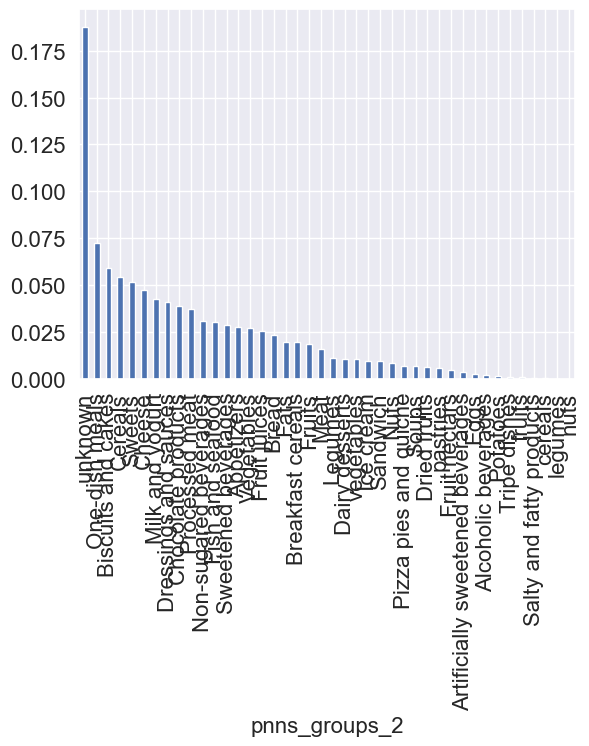

In [73]:
# Diagrammes en tuyaux d'orgues

df_cleaned["nutrition_grade_fr"].value_counts(normalize=True).plot(kind='bar')
plt.show()

df_cleaned["pnns_groups_2"].value_counts(normalize=True).plot(kind='bar')
plt.show()

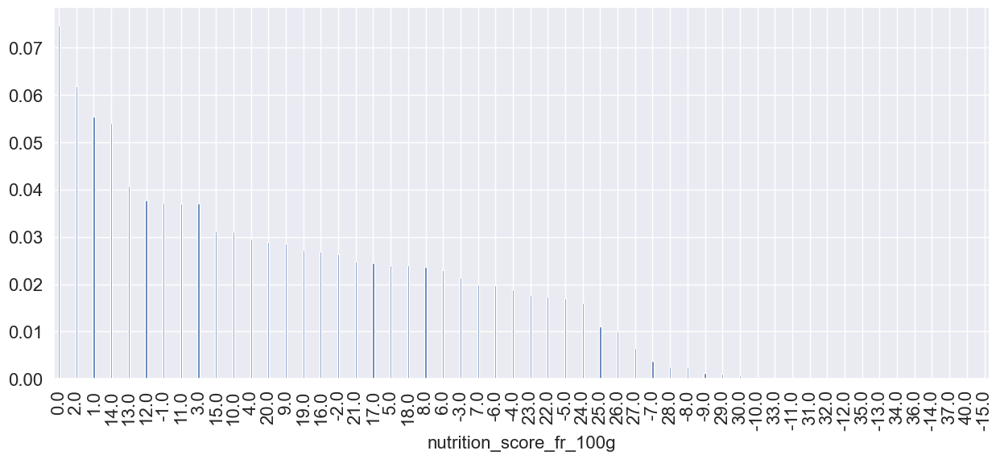

In [74]:
# Diagramme en bâtons
plt.figure(figsize=(15, 6))
df_cleaned["nutrition_score_fr_100g"].value_counts(normalize=True).plot(kind='bar',width=0.1)
plt.show()

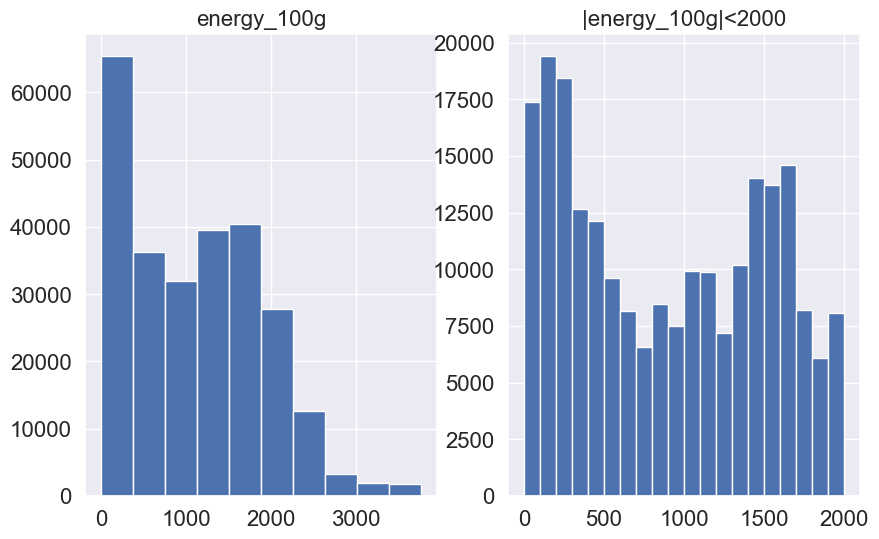

In [75]:
# Histogramme
plt.figure(figsize=(10,6))
plt.subplot(1,2,1)
df_cleaned["energy_100g"].hist(density=False)
plt.title('energy_100g')
plt.subplot(1,2,2)
# Histogramme plus beau
df_cleaned[df_cleaned.energy_100g.abs() < 2000]["energy_100g"].hist(density=False,bins=20)
plt.title('|energy_100g|<2000')
plt.show()

In [76]:
df_cleaned.columns

Index(['code', 'created_t', 'product_name', 'countries_fr', 'ingredients_text',
       'nutrition_grade_fr', 'energy_100g', 'fat_100g', 'saturated_fat_100g',
       'carbohydrates_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g',
       'salt_100g', 'sodium_100g', 'nutrition_score_fr_100g', 'pnns_groups_2'],
      dtype='object')

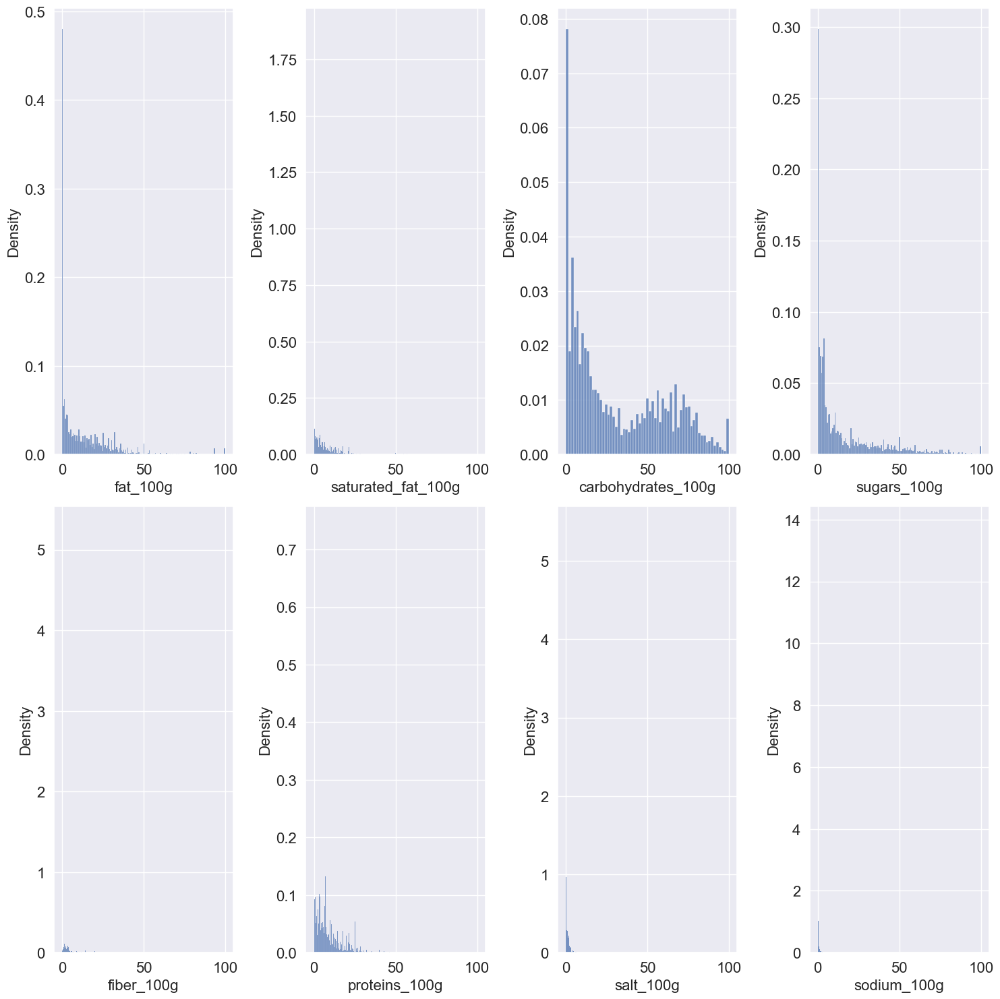

In [77]:
# Columns you want to include in the grid
columns_to_plot = ['fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 'sugars_100g',
                   'fiber_100g', 'proteins_100g', 'salt_100g', 'sodium_100g']

# Calculate the dimensions of the grid based on the number of columns
dimension = len(columns_to_plot)

# Create a grid of plots using plt.subplots
fig, axs = plt.subplots(2, 4, figsize=(15, 15))

# Flatten the axs array to make it easier to iterate
axs = axs.flatten()

# Loop through columns and create histograms
for i, column in enumerate(columns_to_plot):
    sns.histplot(df_cleaned[column], ax=axs[i], stat='density')
    # axs[i].set_title(column)

# Adjust layout to prevent clipping of titles
plt.tight_layout()

# Show the plot
plt.show()


## Analyse bivariée

L'analyse bivariée permet d'étudier la relation entre deux variables. Il est utile de déterminer s'il existe une corrélation entre les variables et, dans l'affirmative, quel est le degré de cette corrélation.

### Pairplots

In [78]:
# sns.pairplot(df_cleaned[['nutrition_score_fr_100g', 'energy_100g', 'fat_100g', 'saturated_fat_100g', 
#                   'carbohydrates_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g', 
#                   'salt_100g', 'sodium_100g', 'nutrition_grade_fr']], 
#              hue='nutrition_grade_fr')

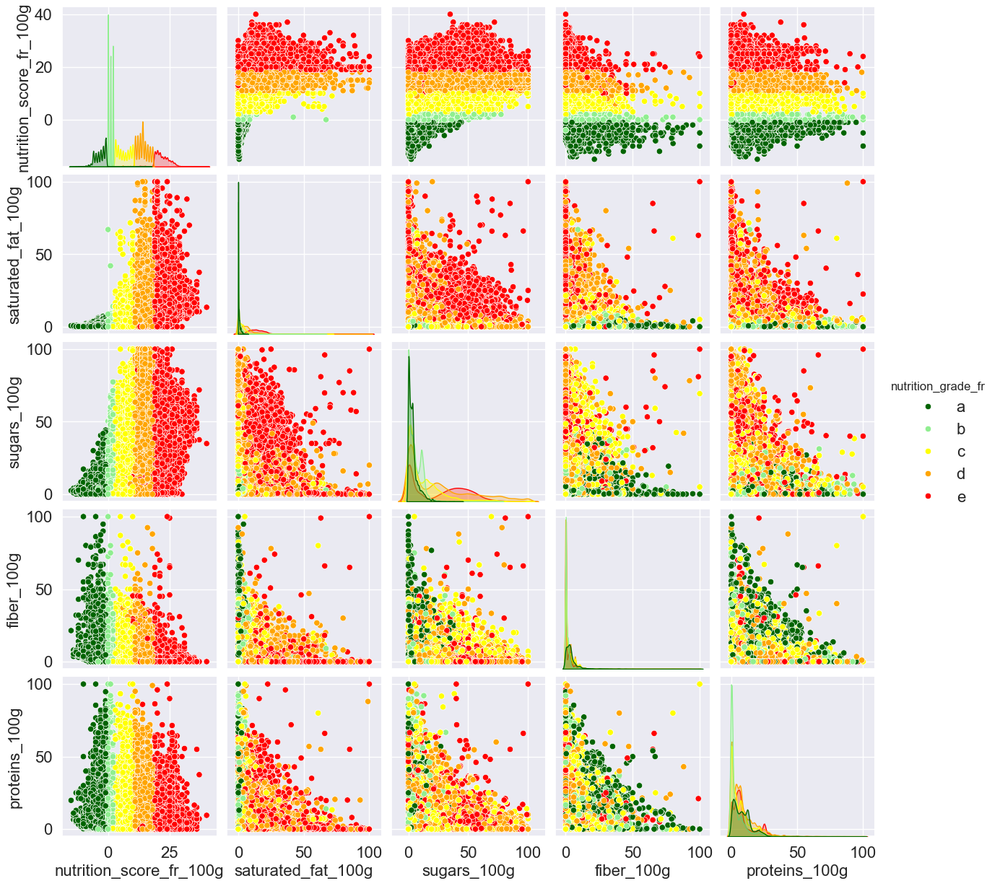

In [79]:
# Colors dictionary
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}

# Set default font size for Seaborn
sns.set(rc={'axes.labelsize': 16, 'axes.titlesize': 16, 'xtick.labelsize': 16, 'ytick.labelsize': 16, 'legend.fontsize': 16})

# Seaborn pairplot with custom color palette and hue order
pair_plot = sns.pairplot(df_cleaned[['nutrition_score_fr_100g', 'saturated_fat_100g', 
                                     'sugars_100g', 'fiber_100g', 'proteins_100g', 'nutrition_grade_fr']], 
                         hue='nutrition_grade_fr', palette=colors, hue_order=['a', 'b', 'c', 'd', 'e'],
                         diag_kind='kde'
                         )


# Show the pair plot
plt.show()


### Quantitatif-Quantitatif

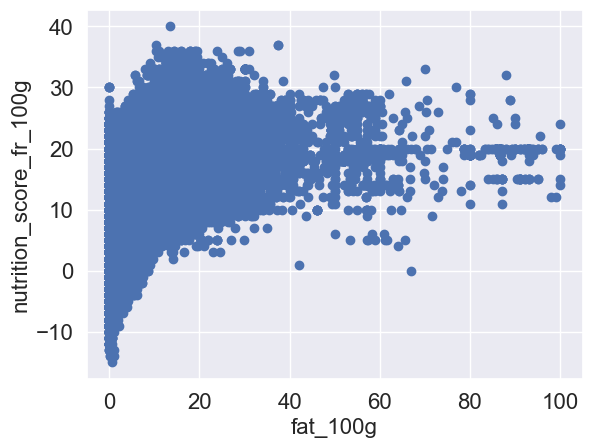

In [80]:
X = "saturated_fat_100g" # quantitative
Y = "nutrition_score_fr_100g" # quantitative

plt.scatter(df_cleaned[X], df_cleaned[Y])
plt.xlabel('fat_100g')
plt.ylabel('nutrition_score_fr_100g')
plt.show()

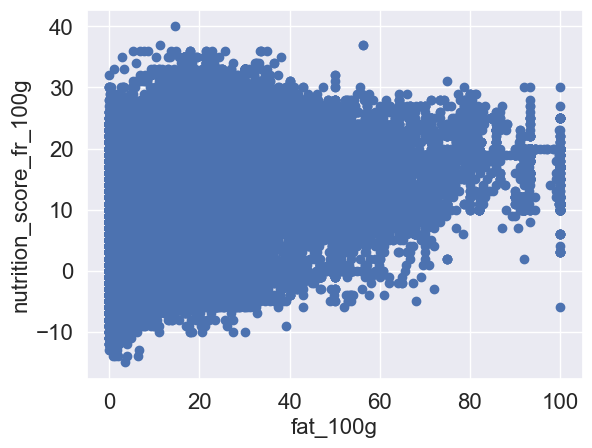

In [81]:
X = "fat_100g" # quantitative
Y = "nutrition_score_fr_100g" # quantitative

plt.scatter(df_cleaned[X], df_cleaned[Y])
plt.xlabel('fat_100g')
plt.ylabel('nutrition_score_fr_100g')
plt.show()

In [82]:
df_cleaned.columns

Index(['code', 'created_t', 'product_name', 'countries_fr', 'ingredients_text',
       'nutrition_grade_fr', 'energy_100g', 'fat_100g', 'saturated_fat_100g',
       'carbohydrates_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g',
       'salt_100g', 'sodium_100g', 'nutrition_score_fr_100g', 'pnns_groups_2'],
      dtype='object')

Ici il serait intéressant d'utiliser plotly pour voir quels aliments très gras ont un bon nutriscore !

### Quantitatif-Qualitatif

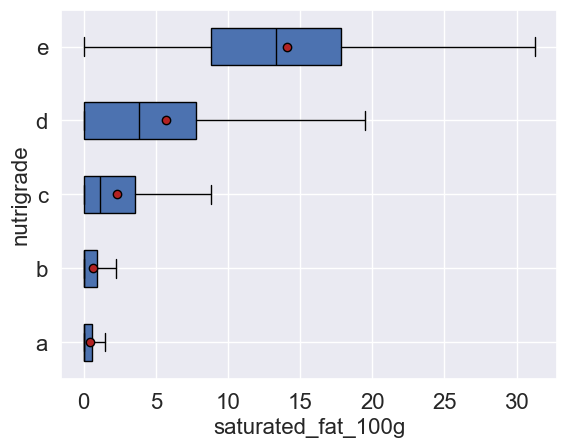

In [85]:
X = "nutrition_grade_fr"  # qualitative
Y = "saturated_fat_100g"  # quantitative

# Define the desired order of modalities
desired_order = ['a', 'b', 'c', 'd', 'e']

# Reorder the modalities based on the desired order
modalites = df_cleaned[X].unique()
modalites_ordered = sorted(modalites, key=lambda x: desired_order.index(x))

groupes = [df_cleaned[df_cleaned[X] == m][Y] for m in modalites_ordered]

# Propriétés graphiques (pas très importantes)
medianprops = {'color': "black"}
meanprops = {'marker': 'o', 'markeredgecolor': 'black',
             'markerfacecolor': 'firebrick'}

plt.boxplot(groupes, labels=modalites_ordered, showfliers=False, medianprops=medianprops,
            vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.xlabel('saturated_fat_100g')
plt.ylabel('nutrigrade')
plt.show()

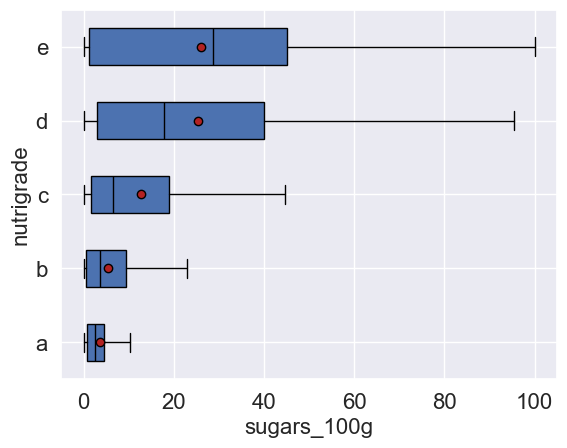

In [86]:
import matplotlib.pyplot as plt

X = "nutrition_grade_fr"  # qualitative
Y = "sugars_100g"  # quantitative

# Define the desired order of modalities
desired_order = ['a', 'b', 'c', 'd', 'e']

# Reorder the modalities based on the desired order
modalites = df_cleaned[X].unique()
modalites_ordered = sorted(modalites, key=lambda x: desired_order.index(x))

groupes = [df_cleaned[df_cleaned[X] == m][Y] for m in modalites_ordered]

# Propriétés graphiques (pas très importantes)
medianprops = {'color': "black"}
meanprops = {'marker': 'o', 'markeredgecolor': 'black',
             'markerfacecolor': 'firebrick'}

plt.boxplot(groupes, labels=modalites_ordered, showfliers=False, medianprops=medianprops,
            vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.xlabel('sugars_100g')
plt.ylabel('nutrigrade')
plt.show()


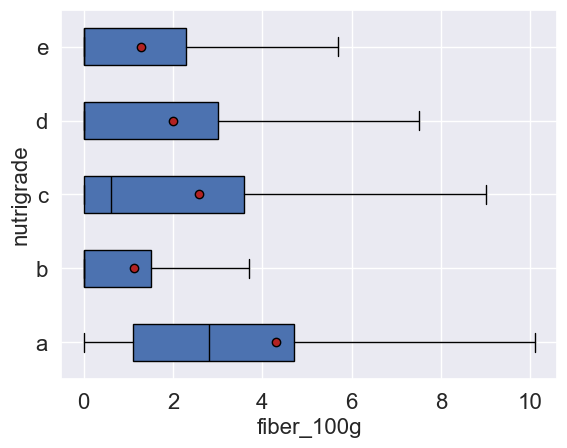

In [87]:
X = "nutrition_grade_fr"  # qualitative
Y = "fiber_100g"  # quantitative

# Define the desired order of modalities
desired_order = ['a', 'b', 'c', 'd', 'e']

# Reorder the modalities based on the desired order
modalites = df_cleaned[X].unique()
modalites_ordered = sorted(modalites, key=lambda x: desired_order.index(x))

groupes = [df_cleaned[df_cleaned[X] == m][Y] for m in modalites_ordered]

# Propriétés graphiques (pas très importantes)
medianprops = {'color': "black"}
meanprops = {'marker': 'o', 'markeredgecolor': 'black',
             'markerfacecolor': 'firebrick'}

plt.boxplot(groupes, labels=modalites_ordered, showfliers=False, medianprops=medianprops,
            vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.xlabel('fiber_100g')
plt.ylabel('nutrigrade')
plt.show()

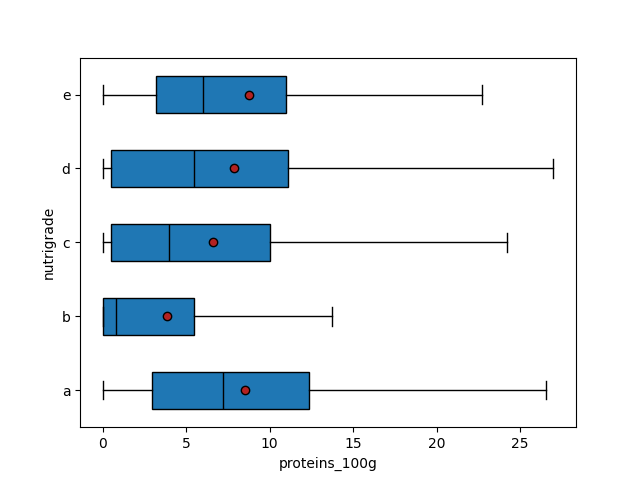

In [168]:
X = "nutrition_grade_fr"  # qualitative
Y = "proteins_100g"  # quantitative

# Define the desired order of modalities
desired_order = ['a', 'b', 'c', 'd', 'e']

# Reorder the modalities based on the desired order
modalites = df_cleaned[X].unique()
modalites_ordered = sorted(modalites, key=lambda x: desired_order.index(x))

groupes = [df_cleaned[df_cleaned[X] == m][Y] for m in modalites_ordered]

# Propriétés graphiques (pas très importantes)
medianprops = {'color': "black"}
meanprops = {'marker': 'o', 'markeredgecolor': 'black',
             'markerfacecolor': 'firebrick'}

plt.figure()
plt.boxplot(groupes, labels=modalites_ordered, showfliers=False, medianprops=medianprops,
            vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
plt.xlabel('proteins_100g')
plt.ylabel('nutrigrade')
plt.show()

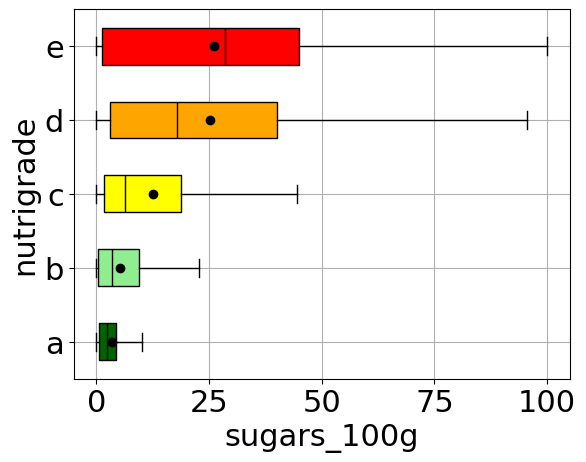

In [9]:

X = "nutrition_grade_fr"  # qualitative
Y = "sugars_100g"  # quantitative

# Define the desired order of modalities
desired_order = ['a', 'b', 'c', 'd', 'e']

# Define the desired order of modalities
modalites = df_cleaned[X].unique()
modalites_ordered = sorted(modalites, key=lambda x: desired_order.index(x))

# Create a color map based on the specified colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}
color_map = [colors[m] for m in modalites_ordered]

# Propriétés graphiques (pas très importantes)
medianprops = {'color': "black"}
meanprops = {'marker': 'o', 'markeredgecolor': 'black', 'markerfacecolor': 'black'}

plt.figure()
plt.rcParams.update({'font.size': 22})
# Create a boxplot with individual colors
bp = plt.boxplot([df_cleaned[df_cleaned[X] == m][Y] for m in modalites_ordered],
                 labels=modalites_ordered, showfliers=False, medianprops=medianprops,
                 vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)

# Set individual box colors
for box, color in zip(bp['boxes'], color_map):
    box.set_facecolor(color)

plt.grid(True)

plt.xlabel('sugars_100g')
plt.ylabel('nutrigrade')
plt.show()

# Reset font.size to its default value
plt.rcParams.update(plt.rcParamsDefault)

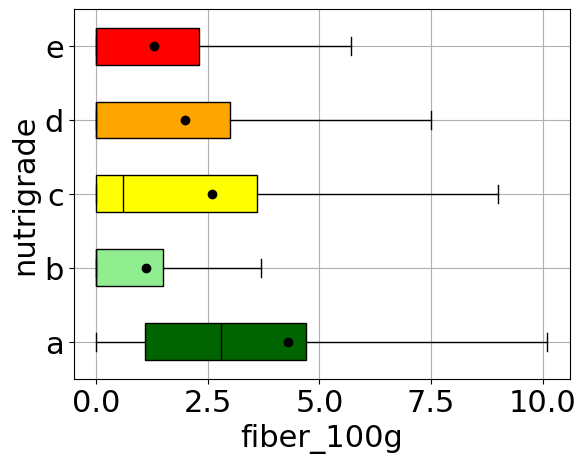

In [8]:
X = "nutrition_grade_fr"  # qualitative
Y = "fiber_100g"  # quantitative

# Define the desired order of modalities
desired_order = ['a', 'b', 'c', 'd', 'e']

# Define the desired order of modalities
modalites = df_cleaned[X].unique()
modalites_ordered = sorted(modalites, key=lambda x: desired_order.index(x))

# Create a color map based on the specified colors
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}
color_map = [colors[m] for m in modalites_ordered]

# Propriétés graphiques (pas très importantes)
medianprops = {'color': "black"}
meanprops = {'marker': 'o', 'markeredgecolor': 'black', 'markerfacecolor': 'black'}

plt.figure()
plt.rcParams.update({'font.size': 22})

# Create a boxplot with individual colors
bp = plt.boxplot([df_cleaned[df_cleaned[X] == m][Y] for m in modalites_ordered],
                 labels=modalites_ordered, showfliers=False, medianprops=medianprops,
                 vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)

# Set individual box colors
for box, color in zip(bp['boxes'], color_map):
    box.set_facecolor(color)

plt.grid(True)

plt.xlabel('fiber_100g')
plt.ylabel('nutrigrade')
plt.show()


# Reset font.size to its default value
plt.rcParams.update(plt.rcParamsDefault)

## Distribution du nustriscore par pays

In [ ]:
unique_values = df_cleaned['countries_fr'].unique()
for value in unique_values:
    print(value)

États-Unis
Royaume-Uni
France,États-Unis
Canada
France
Allemagne
Roumanie
Espagne
France,Royaume-Uni
Belgique,France,Pays-Bas,Royaume-Uni
Canada,États-Unis
Canada,France,Suisse,États-Unis
France,États-Unis,en:Etats-unis
Royaume-Uni,États-Unis
Belgique,France
États-Unis,en:Australie
Arabie saoudite
Australie,États-Unis
Australie
France,Suisse
Australie,Nouvelle-Zélande,Singapour,Thaïlande,États-Unis
États-Unis,en:Pays-bas
Espagne,Royaume-Uni,en:Scotland
Polynésie française,États-Unis
nan
Mexique
Suisse,États-Unis
Allemagne,États-Unis
États-Unis,en:Deutschland
Suisse
France,Suisse,États-Unis
Belgique,Suisse,États-Unis
Danemark,États-Unis,en:Spanien
États-Unis,en:Belgie,en:Nederland
Belgique,Suisse
France,Allemagne
Malaisie,États-Unis
Guyana,États-Unis
Serbie
Hong Kong
Bahreïn,États-Unis
France,Italie
Taiwan,États-Unis
États-Unis,en:Niederlande
Cuba
France,Royaume-Uni,États-Unis
Italie,États-Unis
Suisse,Royaume-Uni
Espagne,États-Unis
Panama,États-Unis
Émirats arabes unis
Costa Rica,États-

### Création d'un nouveau dataframe avec un seul pays par entrée

In [ ]:
# Créer une liste pour stocker les dictionnaires de lignes du nouveau dataframe
new_rows = []

# Pour chaque ligne du dataframe original
for _, row in df_cleaned.iterrows():
    # Vérifier si la valeur de countries_fr n'est pas NaN
    if pd.notna(row['countries_fr']):
        # Diviser les valeurs de countries_fr en une liste
        countries = row['countries_fr'].split(',')
        
        # Pour chaque pays dans la liste
        for country in countries:
            # Créer un dictionnaire représentant la nouvelle ligne
            new_row = row.to_dict()
            new_row['countries_fr'] = country
            
            # Ajouter le dictionnaire à la liste
            new_rows.append(new_row)

# Créer un nouveau dataframe df1 à partir de la liste de dictionnaires
df1 = pd.DataFrame(new_rows)

# Afficher le nouveau dataframe df1
df1.head()

,code,created_t,product_name,countries_fr,ingredients_text,nutrition_grade_fr,energy_100g,fat_100g,saturated_fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutrition_score_fr_100g,pnns_groups_2
0,0000000004530,2017-03-09 14:32:32,Banana Chips Sweetened (Whole),États-Unis,"Bananas, vegetable oil (coconut oil, corn oil ...",d,2243.0,28.57,28.57,64.29,14.290,3.6,3.57,0.000000,0.000000,14.0,NaN
1,0000000004559,2017-03-09 14:32:32,Peanuts,États-Unis,"Peanuts, wheat flour, sugar, rice flour, tapio...",b,1941.0,17.86,0.00,60.71,17.860,7.1,17.86,0.635000,0.250000,0.0,NaN
2,0000000016087,2017-03-09 10:35:44,Organic Salted Nut Mix,États-Unis,"Organic hazelnuts, organic cashews, organic wa...",d,2540.0,57.14,5.36,17.86,3.570,7.1,17.86,1.224280,0.482000,12.0,NaN
3,0000000016094,2017-03-09 10:33:36,Organic Polenta,États-Unis,Organic polenta,a,1552.0,1.43,1.14,77.14,4.428,5.7,8.57,0.849512,0.334454,-5.0,NaN
4,0000000016100,2017-03-09 10:33:36,Breadshop Honey Gone Nuts Granola,États-Unis,"Rolled oats, grape concentrate, expeller press...",a,1933.0,18.27,1.92,63.46,11.540,7.7,13.46,0.431220,0.169772,-2.0,NaN


In [ ]:
unique_values = df1['countries_fr'].unique()
for value in unique_values:
    print(value)

États-Unis
Royaume-Uni
France
Canada
Allemagne
Roumanie
Espagne
Belgique
Pays-Bas
Suisse
en:Etats-unis
en:Australie
Arabie saoudite
Australie
Nouvelle-Zélande
Singapour
Thaïlande
en:Pays-bas
en:Scotland
Polynésie française
Mexique
en:Deutschland
Danemark
en:Spanien
en:Belgie
en:Nederland
Malaisie
Guyana
Serbie
Hong Kong
Bahreïn
Italie
Taiwan
en:Niederlande
Cuba
Panama
Émirats arabes unis
Costa Rica
Israël
Chine
Saint-Pierre-et-Miquelon
Quebec
en:Czech
Turquie
Chili
Nouvelle-Calédonie
en:香港
Grèce
République tchèque
Union européenne
Indonésie
Colombie
Norvège
Suède
Guyane
Pérou
Irlande
Russie
Brésil
Portugal
Chypre
Japon
Autriche
Philippines
Aruba
Liban
Côte d'Ivoire
Îles Vierges des États-Unis
en:Royaume-uni
Lituanie
Sénégal
Maroc
La Réunion
Togo
Corée du Sud
Tunisie
Hongrie
en:Angleterre
en:الإمارات-العربية-المتحدة
en:Island
Pologne
World
en:Gulf-countries
en:السعودية
en:Turkiye
Scotland
Finlande
Afrique du Sud
en:Allemagne
Slovénie
Vereinigtes-konigreich
77-provins
Luxembourg
Guadelou

In [ ]:
# Afficher le nombre d'occurrences de chaque valeur dans la colonne "countries_fr"
occurrences = df1['countries_fr'].value_counts()

# Utiliser une boucle for pour afficher chaque valeur et son occurrence
for country, count in occurrences.items():
    print(f"{country}: {count}")

États-Unis: 171391
France: 64502
Suisse: 12621
Allemagne: 5278
Espagne: 3232
Royaume-Uni: 2132
Belgique: 1301
Russie: 852
Australie: 572
Portugal: 473
Italie: 405
Pays-Bas: 328
Canada: 241
Danemark: 200
Autriche: 146
Hongrie: 134
Guadeloupe: 130
Serbie: 113
Roumanie: 95
Brésil: 87
Suède: 81
Pologne: 77
Nouvelle-Zélande: 71
La Réunion: 69
Guyane: 65
Irlande: 53
Luxembourg: 51
Tunisie: 47
Norvège: 37
République tchèque: 35
Saint-Pierre-et-Miquelon: 33
Maroc: 29
Thaïlande: 29
Hong Kong: 28
Martinique: 27
Mexique: 27
Grèce: 26
Chili: 22
Turquie: 22
Quebec: 21
Chine: 21
Sénégal: 20
Polynésie française: 19
Japon: 18
Deutschland: 18
Monténégro: 18
Nouvelle-Calédonie: 17
Bulgarie: 17
Taiwan: 17
Colombie: 16
Finlande: 15
Slovénie: 15
en:Deutschland: 15
Afrique du Sud: 15
Union européenne: 15
Algérie: 13
Frankreich: 13
Bosnie-Herzégovine: 13
en:Scotland: 12
Croatie: 11
Singapour: 11
Argentine: 11
Inde: 10
en:Azərbaycan: 9
Émirats arabes unis: 9
Slovaquie: 9
en:Nederland: 8
Cambodge: 8
Andorre: 8

### Distribution du nutrigrade par pays pour les 10 pays les plus représentés

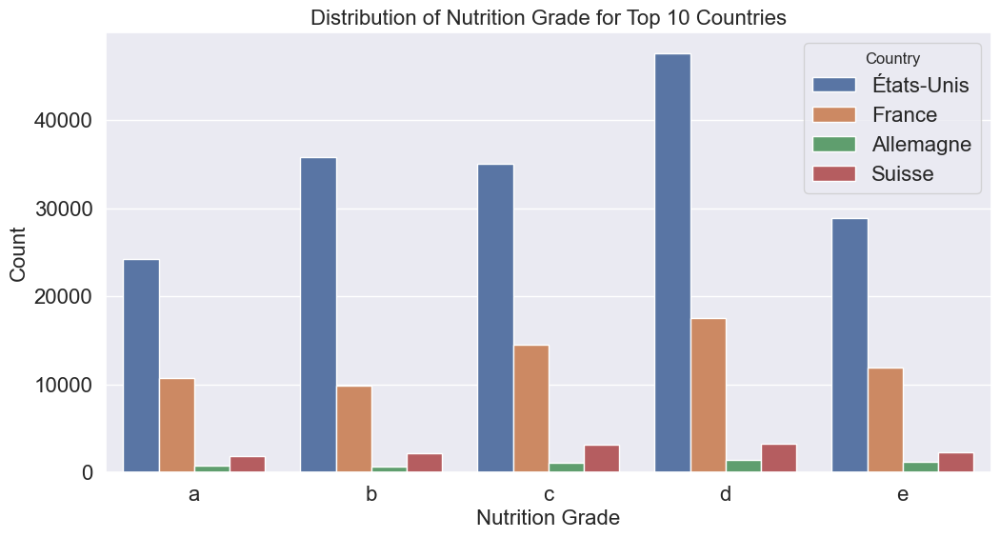

In [ ]:
# Sélectionner les 10 pays les plus représentés
top_countries = df1['countries_fr'].value_counts().head(4).index

# Filtrer le dataframe pour inclure seulement les lignes des 10 pays les plus représentés
df_top_countries = df1[df1['countries_fr'].isin(top_countries)]

# Tracer la distribution de la variable 'nutrition_grade_fr' pour les 10 pays les plus représentés
plt.figure(figsize=(12, 6))
sns.countplot(x='nutrition_grade_fr', hue='countries_fr', data=df_top_countries, order=sorted(df_top_countries['nutrition_grade_fr'].unique()))
plt.xlabel('Nutrition Grade')
plt.ylabel('Count')
plt.title('Distribution of Nutrition Grade for Top 10 Countries')
plt.legend(title='Country', bbox_to_anchor=(1, 1))
plt.show()

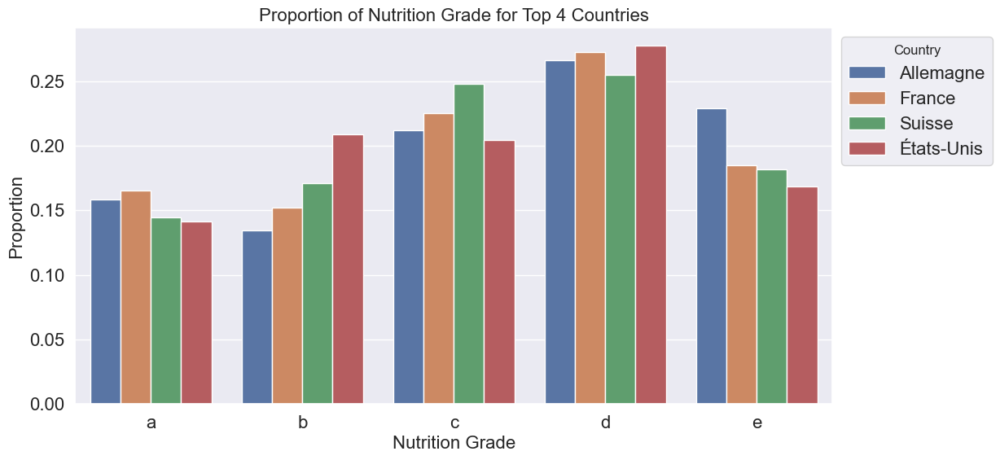

In [ ]:
# Sélectionner les 4 pays les plus représentés
top_countries = df1['countries_fr'].value_counts().head(4).index

# Filtrer le dataframe pour inclure seulement les lignes des 10 pays les plus représentés
df_top_countries = df1[df1['countries_fr'].isin(top_countries)]

# Calculer la proportion des différents nutrition_grade_fr pour chaque pays
df_proportion = df_top_countries.groupby(['countries_fr', 'nutrition_grade_fr']).size().div(df_top_countries.groupby('countries_fr').size()).reset_index(name='proportion')

# Tracer la distribution des proportions de la variable 'nutrition_grade_fr' pour les 10 pays les plus représentés
plt.figure(figsize=(12, 6))
sns.barplot(x='nutrition_grade_fr', y='proportion', hue='countries_fr', data=df_proportion, order=sorted(df_top_countries['nutrition_grade_fr'].unique()))
plt.xlabel('Nutrition Grade')
plt.ylabel('Proportion')
plt.title('Proportion of Nutrition Grade for Top 4 Countries')
plt.legend(title='Country', bbox_to_anchor=(1, 1))
plt.show()

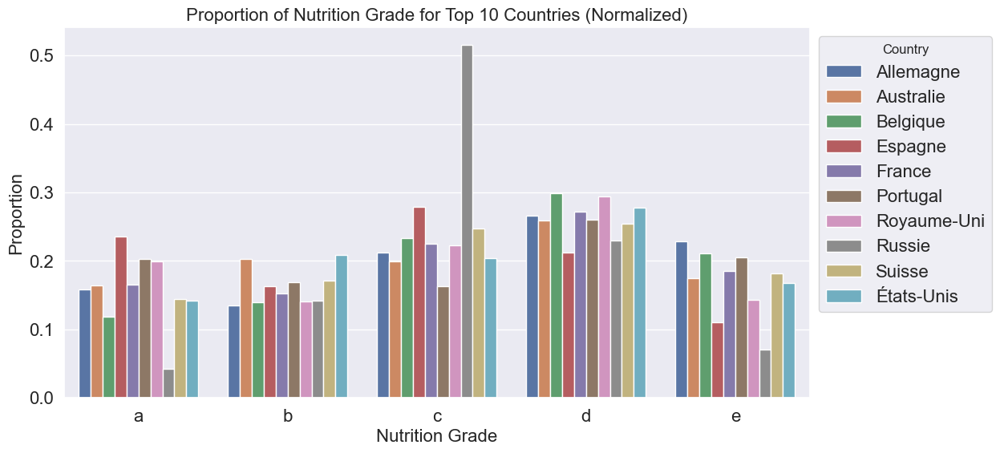

In [ ]:
# Sélectionner les 10 pays les plus représentés
top_countries = df1['countries_fr'].value_counts().head(10).index

# Filtrer le dataframe pour inclure seulement les lignes des 10 pays les plus représentés
df_top_countries = df1[df1['countries_fr'].isin(top_countries)]

# Calculer la proportion des différents nutrition_grade_fr pour chaque pays
df_proportion = df_top_countries.groupby(['countries_fr', 'nutrition_grade_fr']).size().div(df_top_countries.groupby('countries_fr')['nutrition_grade_fr'].count()).reset_index(name='proportion')

# Tracer la distribution des proportions de la variable 'nutrition_grade_fr' pour les 10 pays les plus représentés
plt.figure(figsize=(12, 6))
sns.barplot(x='nutrition_grade_fr', y='proportion', hue='countries_fr', data=df_proportion, order=sorted(df_top_countries['nutrition_grade_fr'].unique()))
plt.xlabel('Nutrition Grade')
plt.ylabel('Proportion')
plt.title('Proportion of Nutrition Grade for Top 10 Countries (Normalized)')
plt.legend(title='Country', bbox_to_anchor=(1, 1))
plt.show()

## Analyse Multivariée

### Qualitatif-Qualitatif : tableau de contingence

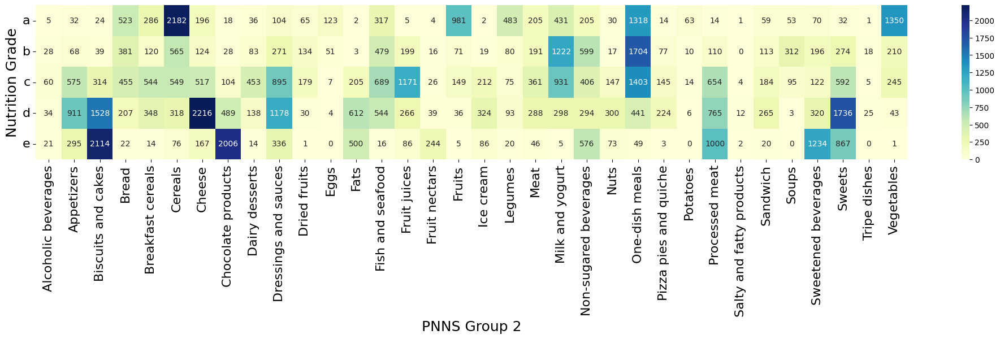

In [43]:
# Remove specified categories
categories_to_remove = ['unknown', 'cereals', 'fruits', 'legumes', 'nuts', 'pastries', 'vegetables', 'Artificially sweetened beverages']
df_cleaned_filtered = df_cleaned[~df_cleaned['pnns_groups_2'].isin(categories_to_remove)].copy()

# Create the contingency table
tableau_contingence = pd.crosstab(df_cleaned_filtered['nutrition_grade_fr'], df_cleaned_filtered['pnns_groups_2'])

# Adjust font size for labels
label_size = 16  # You can adjust this size as needed

# Replotting with increased label size
plt.figure(figsize=(20, 5))
sns.heatmap(tableau_contingence, annot=True, fmt='d', cmap='YlGnBu', cbar=True)
plt.tight_layout()

# Setting the label sizes
plt.ylabel('Nutrition Grade', fontsize=label_size+2)
plt.xlabel('PNNS Group 2', fontsize=label_size+2)
plt.xticks(fontsize=label_size)
plt.yticks(fontsize=label_size, rotation=0)

plt.show()

### Scatterplots with noise:
Normally, if you try to use a scatter plot to plot two categorical features, you would just get a few points, each one containing a lot of instances from the data. So, to get a sense of how many there really are in each point, we can add some random noise to each instance:

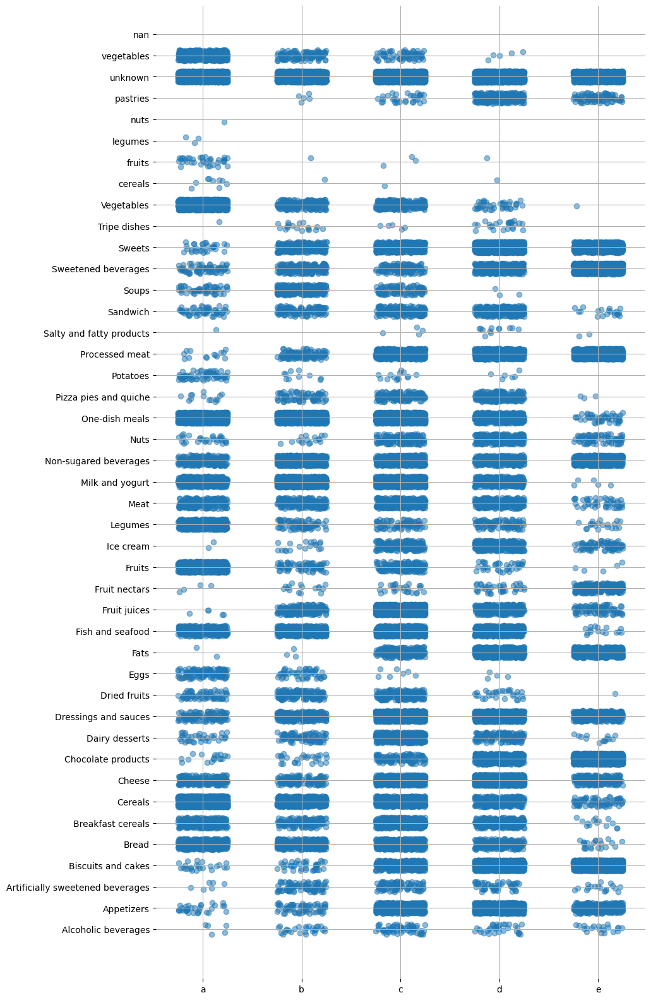

In [15]:
# Assuming df_cleaned is your pre-cleaned DataFrame
ord_enc = OrdinalEncoder()
enc_df = pd.DataFrame(ord_enc.fit_transform(df_cleaned), columns=list(df_cleaned.columns))

# Handling categories for each column separately
categories_dict = {}
for col, cat in zip(df_cleaned.columns, ord_enc.categories_):
    categories_dict[col] = cat

# Generate the random noise
xnoise, ynoise = np.random.random(len(df_cleaned))/2, np.random.random(len(df_cleaned))/2 # Noise in the range 0 to 0.5

plt.figure(figsize=(10, 20))

# Plot the scatterplot
plt.scatter(enc_df["nutrition_grade_fr"] + xnoise, enc_df["pnns_groups_2"] + ynoise, alpha=0.5)

# Set xticks and yticks with category names
# Adjust the tick positions and labels as per the number of categories in each column
plt.xticks(np.arange(len(categories_dict["nutrition_grade_fr"])) + 0.25, categories_dict["nutrition_grade_fr"])
plt.yticks(np.arange(len(categories_dict["pnns_groups_2"])) + 0.25, categories_dict["pnns_groups_2"])

# Extra styling
plt.grid()
sns.despine(left=True, bottom=True)

plt.show()

### Matrice de corrélations

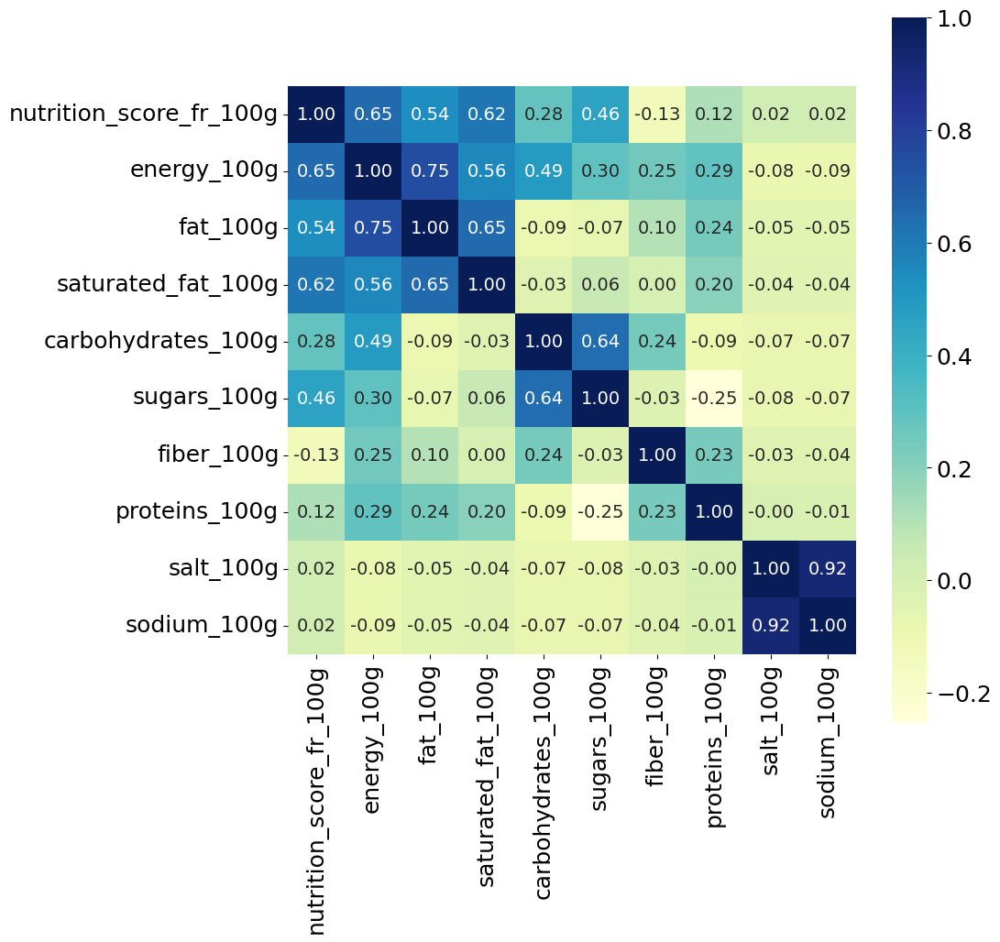

In [46]:
fig, ax = plt.subplots(figsize=(10, 10))
# ax.set_title('Matrice de corrélation', fontdict={'fontsize':18}, x=0.5, y=1.1)

# Create the heatmap
corr_heatmap = sns.heatmap(df_cleaned[['nutrition_score_fr_100g', 'energy_100g', 'fat_100g', 
                                       'saturated_fat_100g', 'carbohydrates_100g', 'sugars_100g', 
                                       'fiber_100g', 'proteins_100g', 'salt_100g', 'sodium_100g']].corr(), 
                           annot=True, square=True, ax=ax, fmt='.2f', cmap='YlGnBu')

# Modify font size of the labels
plt.xticks(fontsize=18) # Adjust as needed
plt.yticks(fontsize=18) # Adjust as needed

# If you want to modify the annotation font size, you will need to iterate over the text annotations
for text in corr_heatmap.texts:
    text.set_size(14) # Adjust as needed

# Modify colorbar label fontsize
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=18) # Adjust as needed

plt.show()

## Analyse en composantes principales

In [48]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260756 entries, 0 to 260755
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   code                     260756 non-null  object 
 1   created_t                260756 non-null  object 
 2   product_name             257421 non-null  object 
 3   countries_fr             260687 non-null  object 
 4   ingredients_text         233949 non-null  object 
 5   nutrition_grade_fr       260756 non-null  object 
 6   energy_100g              260756 non-null  float64
 7   fat_100g                 260756 non-null  float64
 8   saturated_fat_100g       260756 non-null  float64
 9   carbohydrates_100g       260756 non-null  float64
 10  sugars_100g              260756 non-null  float64
 11  fiber_100g               260756 non-null  float64
 12  proteins_100g            260756 non-null  float64
 13  salt_100g                260756 non-null  float64
 14  sodi

### Scree plot et individus dans les 2 premières composantes

In [93]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260756 entries, 0 to 260755
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   code                     260756 non-null  object 
 1   created_t                260756 non-null  object 
 2   product_name             257421 non-null  object 
 3   countries_fr             260687 non-null  object 
 4   ingredients_text         233949 non-null  object 
 5   nutrition_grade_fr       260756 non-null  object 
 6   energy_100g              260756 non-null  float64
 7   fat_100g                 260756 non-null  float64
 8   saturated_fat_100g       260756 non-null  float64
 9   carbohydrates_100g       260756 non-null  float64
 10  sugars_100g              260756 non-null  float64
 11  fiber_100g               260756 non-null  float64
 12  proteins_100g            260756 non-null  float64
 13  salt_100g                260756 non-null  float64
 14  sodi

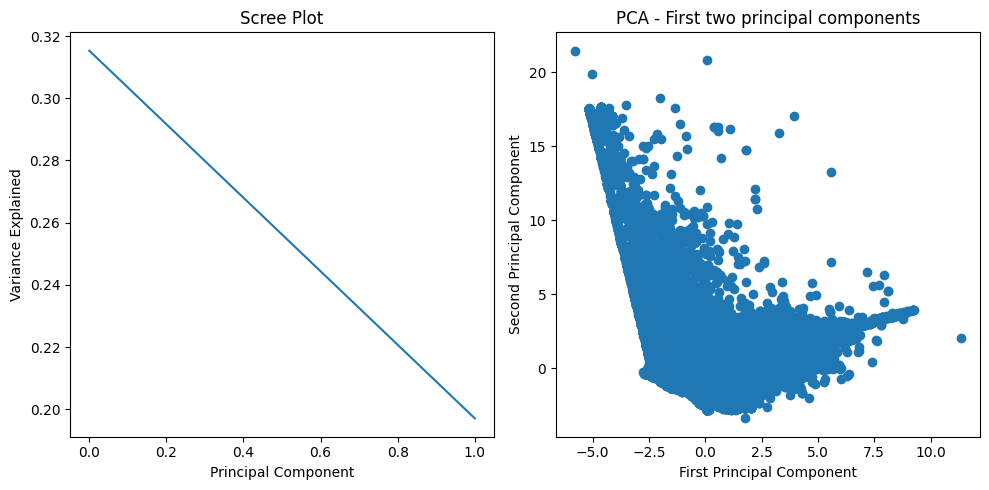

In [4]:
# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_cleaned[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)

# Application de l'ACP
pca = PCA(n_components=2)  # Utilisation de 2 composantes pour la démonstration
pca_result = pca.fit_transform(df_cleaned_scaled)

# Visualisation des résultats

# Scree Plot
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(pca.explained_variance_ratio_)
plt.title("Scree Plot")
plt.xlabel("Principal Component")
plt.ylabel("Variance Explained")

# Plot des individus pour les deux premiers composants principaux
plt.subplot(1, 2, 2)
plt.scatter(pca_result[:, 0], pca_result[:, 1])
plt.title("PCA - First two principal components")
plt.xlabel("First Principal Component")
plt.ylabel("Second Principal Component")

plt.tight_layout()
plt.show()

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_4678/4131208801.py:36: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/Users/anthonydavid/miniconda3/envs/OC-env/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


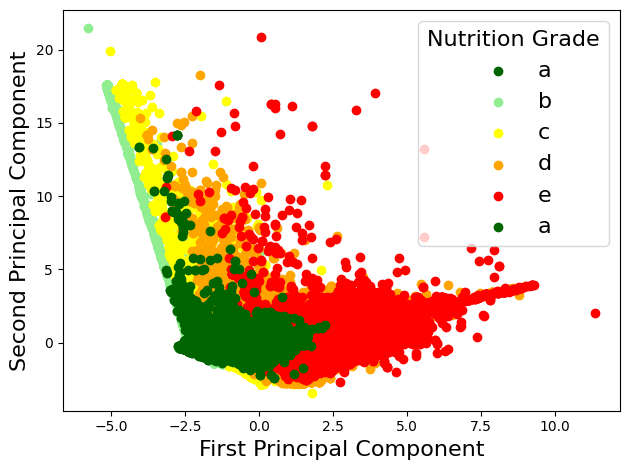

In [122]:
# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_cleaned[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)

# Application de l'ACP avec 2 composantes
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df_cleaned_scaled)

# Mapping des grades nutritionnels à des couleurs
colors = {'a': 'darkgreen', 'b': 'lightgreen', 'c': 'yellow', 'd': 'orange', 'e': 'red'}
df_cleaned['colors'] = df_cleaned['nutrition_grade_fr'].map(colors)

# Plot des individus pour les deux premiers composants principaux avec des couleurs pour le nutrigrade
# plt.figure(figsize=(12, 6))
plt.figure()
for grade in colors.keys():
    subset = df_cleaned[df_cleaned['nutrition_grade_fr'] == grade]
    plt.scatter(pca_result[subset.index, 0], pca_result[subset.index, 1], color=colors[grade], label=grade)

for grade in ['a']:
    subset = df_cleaned[df_cleaned['nutrition_grade_fr'] == grade]
    plt.scatter(pca_result[subset.index, 0], pca_result[subset.index, 1], color=colors[grade], label=grade)

# plt.title("PCA - First two principal components with Nutritional Grades")
plt.xlabel("First Principal Component", fontsize=16)
plt.ylabel("Second Principal Component", fontsize=16)
plt.legend(title='Nutrition Grade', fontsize=16, title_fontsize=16)
plt.tight_layout()
plt.show()

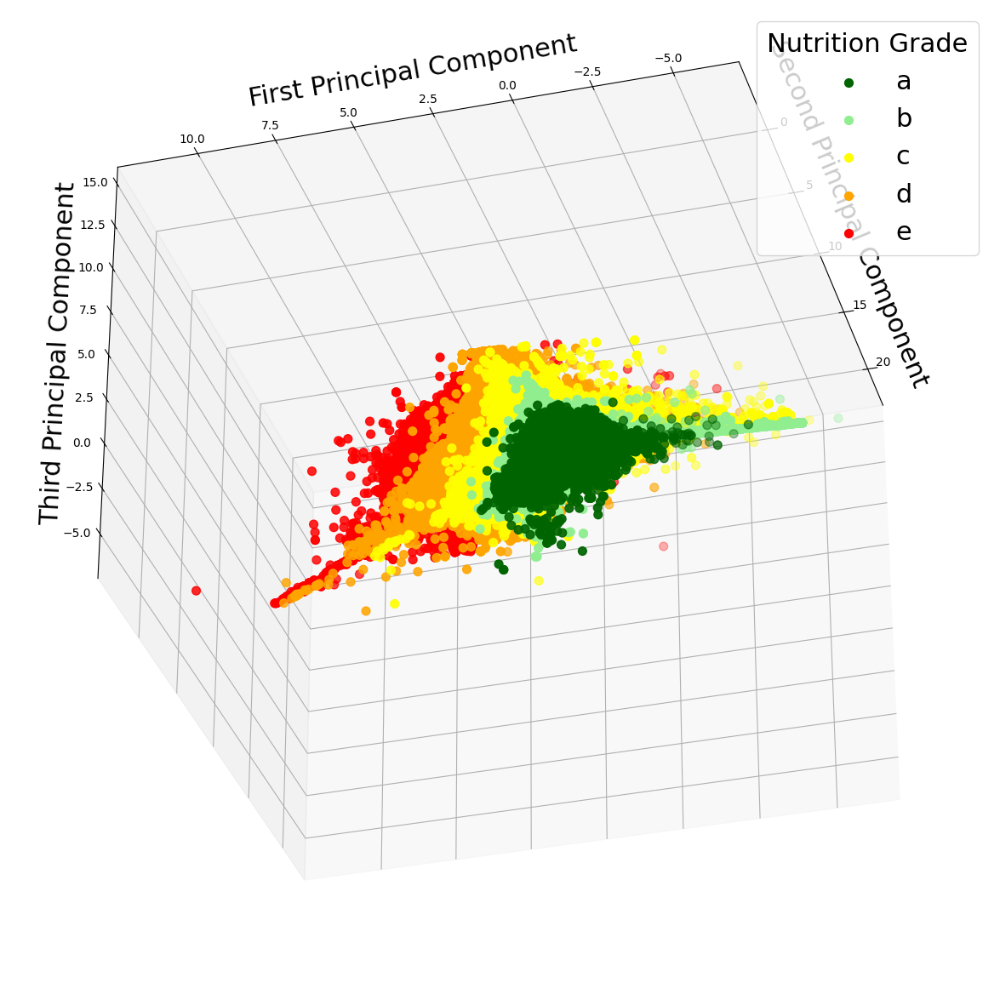

In [123]:
from mpl_toolkits.mplot3d import Axes3D

# Réalisation d'une ACP avec 3 composantes
pca_3 = PCA(n_components=3)
pca_result_3 = pca_3.fit_transform(df_cleaned_scaled)

# Création du plot 3D
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111, projection='3d')

# Ajout des points avec des couleurs pour le nutrigrade
for grade in colors.keys():
    subset = df_cleaned[df_cleaned['nutrition_grade_fr'] == grade]
    ax.scatter(pca_result_3[subset.index, 1], pca_result_3[subset.index, 0], pca_result_3[subset.index, 2], 
               color=colors[grade], label=grade, s=50)
    
# for grade in ['a']:
#     subset = df_cleaned[df_cleaned['nutrition_grade_fr'] == grade]
#     ax.scatter(pca_result_3[subset.index, 0], pca_result_3[subset.index, 1], pca_result_3[subset.index, 2], 
#                color=colors[grade], label=grade, s=50)

# Réglage des angles d'élévation et d'azimut
ax.view_init(elev=-32, azim=-164)  # Vous pouvez modifier ces valeurs pour changer l'orientation

# ax.set_title("PCA - First three principal components with Nutritional Grades")
ax.set_xlabel("Second Principal Component", fontsize=22)
ax.set_ylabel("First Principal Component", fontsize=22)
ax.set_zlabel("Third Principal Component", fontsize=22)
ax.legend(title='Nutrition Grade', fontsize=22, title_fontsize=22)

plt.show()


In [133]:
# Création d'un DataFrame pour la visualisation
# Dans votre cas, utilisez les résultats réels de l'ACP (pca_result_3) et les grades nutritionnels de 'df_cleaned'
df_for_plot = pd.DataFrame({
    'First Principal Component': pca_result_3[:, 0],
    'Second Principal Component': pca_result_3[:, 1],
    'Third Principal Component': pca_result_3[:, 2],
    'Nutrition Grade': df_cleaned['nutrition_grade_fr']
})

# Création du plot 3D avec Plotly Express
fig = px.scatter_3d(df_for_plot, x='Second Principal Component', y='First Principal Component', 
                    z='Third Principal Component', color='Nutrition Grade',
                    color_discrete_map=colors, title='PCA - First three principal components with Nutritional Grades')

# Conversion des angles en radians
elev = math.radians(32)
azim = math.radians(164)

# Choisissez un rayon r approprié
r = 1.25

# Calcul des coordonnées x, y, z
x = r * math.cos(elev) * math.sin(azim)
y = r * math.cos(elev) * math.cos(azim)
z = r * math.sin(elev)

# Utilisation de ces coordonnées pour la position de la caméra dans Plotly
camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=x, y=y, z=z)
)

# Réglages supplémentaires
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

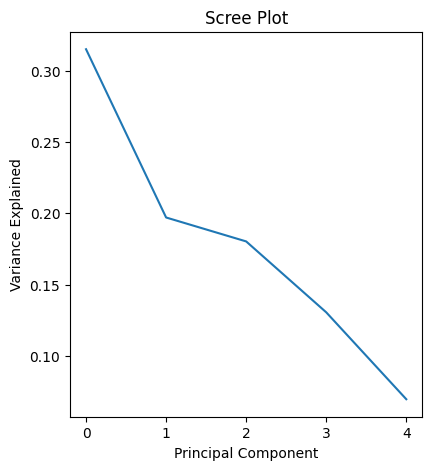

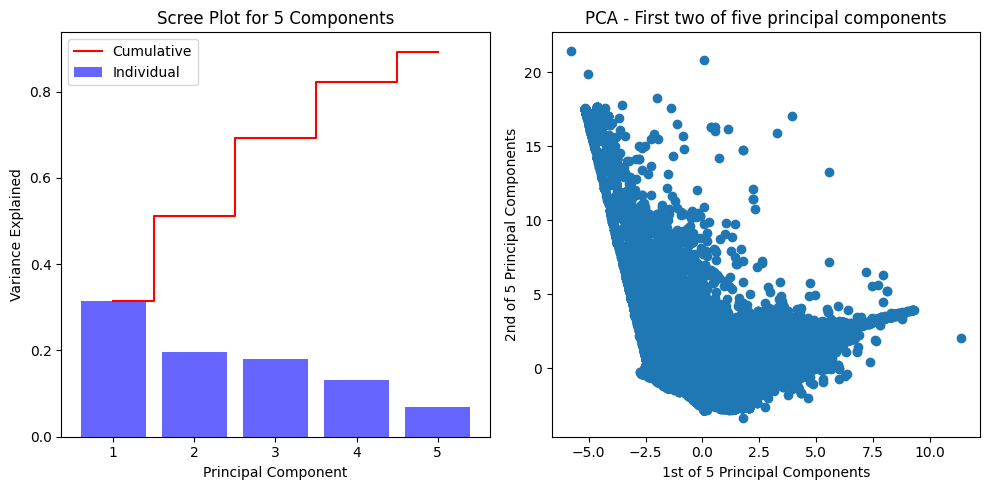

(array([0.31528626, 0.197101  , 0.18029405, 0.13049754, 0.06945786]),
 array([0.31528626, 0.51238725, 0.6926813 , 0.82317884, 0.8926367 ]))

In [124]:
# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_cleaned[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)


# Réappliquer l'ACP avec 5 composantes
pca_5 = PCA(n_components=5)
pca_result_5 = pca_5.fit_transform(df_cleaned_scaled)


# Scree Plot
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(pca_5.explained_variance_ratio_)
plt.title("Scree Plot")
plt.xlabel("Principal Component")
plt.ylabel("Variance Explained")


# Scree Plot pour 5 composantes
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.bar(range(1, 6), pca_5.explained_variance_ratio_, alpha=0.6, color='blue', label='Individual')
plt.step(range(1, 6), pca_5.explained_variance_ratio_.cumsum(), where='mid', color='red', label='Cumulative')
plt.title("Scree Plot for 5 Components")
plt.xlabel("Principal Component")
plt.ylabel("Variance Explained")
plt.legend(loc='best')

# Plot des individus pour les deux premières composantes parmi les 5
plt.subplot(1, 2, 2)
plt.scatter(pca_result_5[:, 0], pca_result_5[:, 1])
plt.title("PCA - First two of five principal components")
plt.xlabel("1st of 5 Principal Components")
plt.ylabel("2nd of 5 Principal Components")

plt.tight_layout()
plt.show()

# Variance expliquée par les 5 composantes
pca_5.explained_variance_ratio_[:5], pca_5.explained_variance_ratio_.cumsum()[:5]

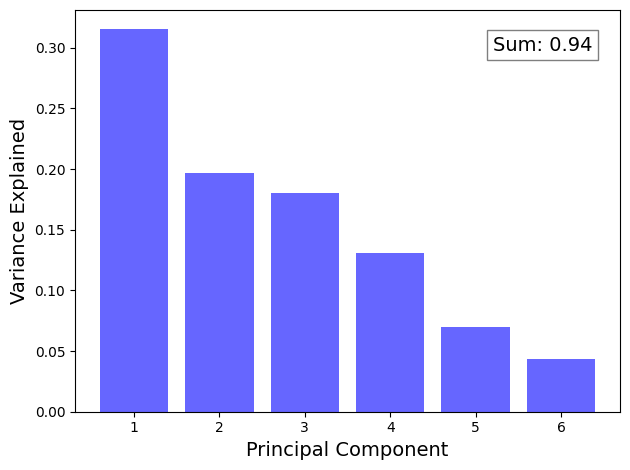

(array([0.31528626, 0.197101  , 0.18029405, 0.13049754, 0.06945786,
        0.0430455 ]),
 array([0.31528626, 0.51238725, 0.6926813 , 0.82317884, 0.8926367 ,
        0.9356822 ]))

In [100]:

# Réappliquer l'ACP avec 6 composantes
pca_6 = PCA(n_components=6)
pca_result_6 = pca_6.fit_transform(df_cleaned_scaled)



# # Scree Plot
# plt.figure(figsize=(10, 5))
# plt.subplot(1, 2, 1)
# plt.plot(pca_6.explained_variance_ratio_)
# plt.title("Scree Plot")
# plt.xlabel("Principal Component")
# plt.ylabel("Variance Explained")

# # Scree Plot pour 6 composantes
# plt.figure(figsize=(12, 6))

# Scree Plot montrant la variance expliquée individuelle et cumulative
# plt.subplot(1, 2, 1)
plt.figure()
plt.bar(range(1, 7), pca_6.explained_variance_ratio_, alpha=0.6, color='blue', label='Individual')
# plt.step(range(1, 7), pca_6.explained_variance_ratio_.cumsum(), where='mid', color='red', label='Cumulative')
# plt.title("Scree Plot for 6 Components")
plt.xlabel("Principal Component", fontsize=14)
plt.ylabel("Variance Explained", fontsize=14)
# plt.legend(loc='best')

# # Plot des individus pour les deux premières composantes parmi les 6
# plt.subplot(1, 2, 2)
# plt.figure()
# plt.scatter(pca_result_6[:, 0], pca_result_6[:, 1])
# plt.title("PCA - First two of six principal components")
# plt.xlabel("1st of 6 Principal Components")
# plt.ylabel("2nd of 6 Principal Components")

# Calcul et affichage de la somme des variances expliquées dans une légende
total_variance = np.sum(pca_6.explained_variance_ratio_)
plt.text(5.2, 0.2975, f'Sum: {total_variance:.2f}', bbox=dict(facecolor='white', alpha=0.5), fontsize=14)


plt.tight_layout()
plt.show()

# Variance expliquée par les 6 composantes
explained_variance_6 = pca_6.explained_variance_ratio_
cumulative_variance_6 = pca_6.explained_variance_ratio_.cumsum()

explained_variance_6, cumulative_variance_6

Text(0, 0.5, 'Variance Explained')

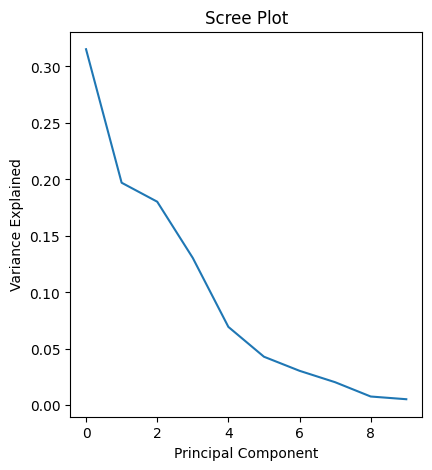

In [11]:

# Réappliquer l'ACP avec 6 composantes
pca_10 = PCA(n_components=10)
pca_result_10 = pca_10.fit_transform(df_cleaned_scaled)



# Scree Plot
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(pca_10.explained_variance_ratio_)
plt.title("Scree Plot")
plt.xlabel("Principal Component")
plt.ylabel("Variance Explained")

### Cercle des corrélations

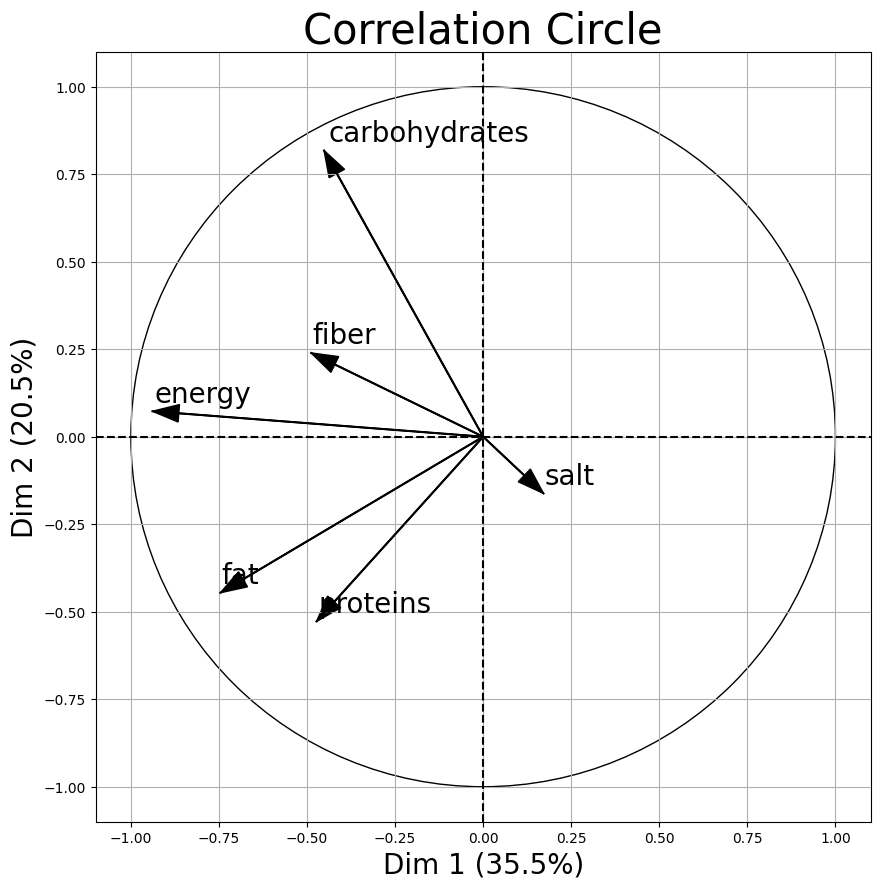

In [47]:
# Utilisation d'un échantillon aléatoire de 5000 lignes pour éviter un crash du noyau
df_sample = df_cleaned.sample(n=5000, random_state=42)

X = df_sample[['energy_100g', 'fat_100g', 
                'carbohydrates_100g', 'fiber_100g', 'proteins_100g', 
                'salt_100g']]

X_norm = X / X.std(axis=0) # Normalizing the feature columns is recommended

feature_names = ['energy', 'fat', 
                'carbohydrates', 'fiber', 'proteins', 
                'salt']

figure, correlation_matrix = plot_pca_correlation_graph(X_norm, 
                                                        feature_names,
                                                        dimensions=(1, 2),
                                                        figure_axis_size=10)

# Récupérer l'axe (axes) du plot
ax = figure.get_axes()[0]

# Ajouter une grille à l'axe
ax.grid(True)

# Afficher le plot
plt.show()

L'interprétation du cercle de corrélation n'est pas équivoque. Le fait est dû au faible nombre de variables en entrée ainsi qu'une qualité de projection moyenne. 

Nous pouvons tout de même observer que la première composante principale est définiee par le niveau de calories et de graisse des observations. La définition de la seconde est moins évidente. Elle oppose les produits riches en protéines aux produits riches en sucres et glucides.

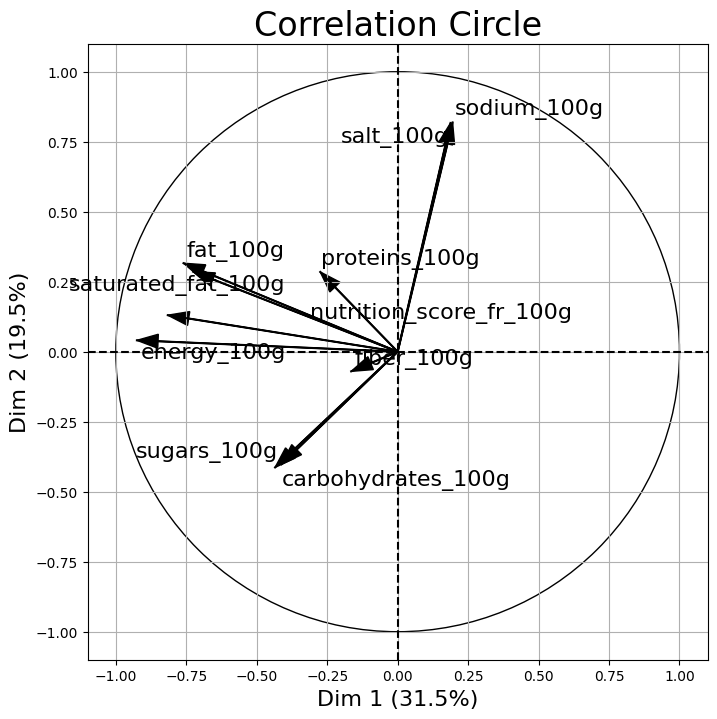

In [20]:
# Utilisation d'un échantillon aléatoire de 5000 lignes pour éviter un crash du noyau
df_sample = df_cleaned.sample(n=5000, random_state=42)


# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_sample[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)


# 3) Créer un cercle de corrélation pour les deux premières composantes principales
figure, correlation_matrix = plot_pca_correlation_graph(df_cleaned_scaled, 
                                                        numeric_columns,
                                                        dimensions=(1, 2),
                                                        figure_axis_size=8)

# Récupérer l'axe (axes) du plot
ax = figure.get_axes()[0]

# Ajouter une grille à l'axe
ax.grid(True)


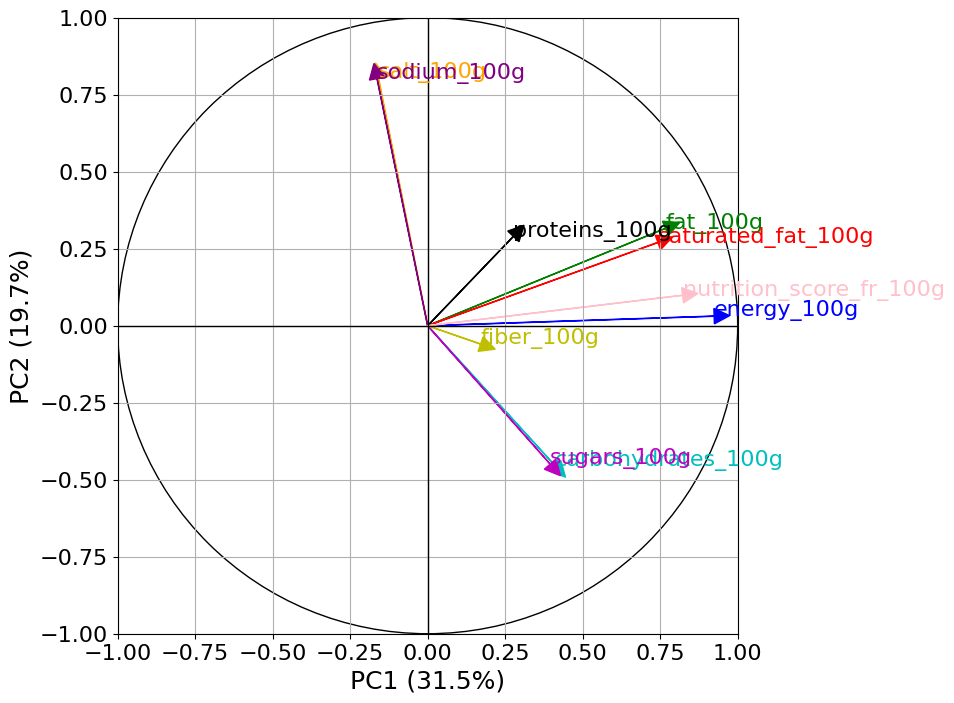

In [107]:
# Assurons-nous que 'pca_5' est l'objet PCA ajusté avec les données 'df_cleaned_scaled'
# pca_5 = PCA(n_components=5).fit(df_cleaned_scaled)
# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_cleaned[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)


# Réappliquer l'ACP avec 5 composantes
pca_5 = PCA(n_components=5)
pca_result_5 = pca_5.fit_transform(df_cleaned_scaled)

# Récupérons les chargements (loadings)
loadings = pca_5.components_.T * np.sqrt(pca_5.explained_variance_)


label_size = 16

# Créons le cercle de corrélation
fig, ax = plt.subplots(figsize=(8, 8))

# Définissons les couleurs pour chaque variable
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'purple', 'pink']

# Ajoutons des flèches et des labels
for i in range(loadings.shape[0]):
    ax.arrow(0, 0, loadings[i, 0], loadings[i, 1], color=colors[i], 
             head_width=0.05, head_length=0.05)
    plt.text(loadings[i, 0], loadings[i, 1], numeric_columns[i], color=colors[i], fontsize=label_size)

# Dessinons le cercle unitaire
circle = plt.Circle((0, 0), 1, color='black', fill=False)
ax.add_artist(circle)

# Définissons les limites des axes
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
plt.xticks(fontsize=label_size)
plt.yticks(fontsize=label_size)

# Afficher le pourcentage de variance expliquée dans les labels des axes
variance_explained_pc1 = pca_5.explained_variance_ratio_[0] * 100  # pour la PC1
variance_explained_pc2 = pca_5.explained_variance_ratio_[1] * 100  # pour la PC2
ax.set_xlabel(f'PC1 ({variance_explained_pc1:.1f}%)', fontsize=label_size+2)
ax.set_ylabel(f'PC2 ({variance_explained_pc2:.1f}%)', fontsize=label_size+2)

# ax.set_title('Cercle de corrélation pour PC1 et PC2')
ax.axhline(0, color='black', lw=1)
ax.axvline(0, color='black', lw=1)

plt.grid()

# Affichons le cercle de corrélation
plt.show()

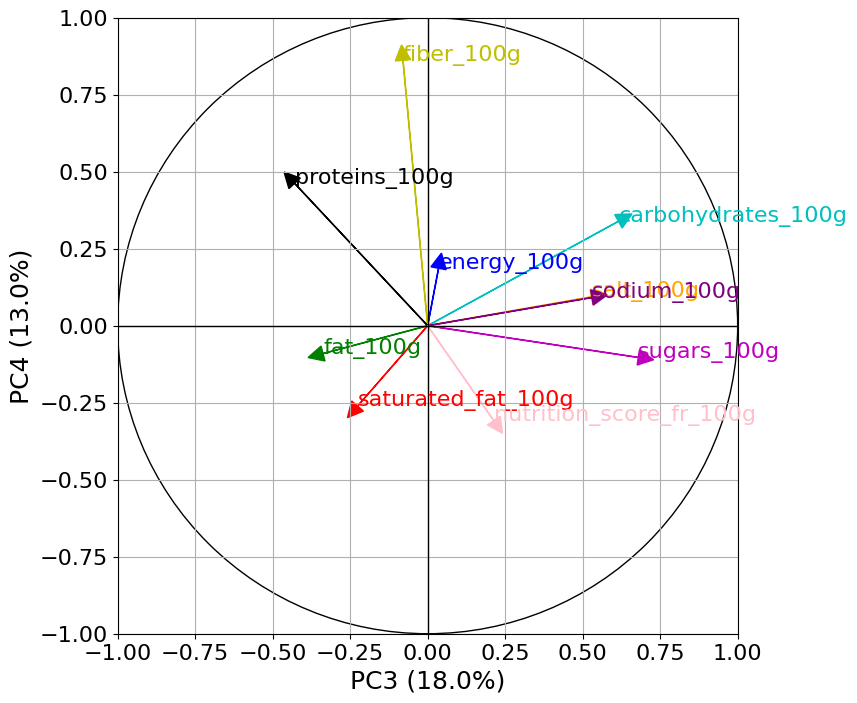

In [110]:
# Assurons-nous que 'pca_5' est l'objet PCA ajusté avec les données 'df_cleaned_scaled'
# pca_5 = PCA(n_components=5).fit(df_cleaned_scaled)
# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_cleaned[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)


# Réappliquer l'ACP avec 5 composantes
pca_5 = PCA(n_components=5)
pca_result_5 = pca_5.fit_transform(df_cleaned_scaled)

# Récupérons les chargements (loadings)
loadings = pca_5.components_.T * np.sqrt(pca_5.explained_variance_)


label_size = 16

# Créons le cercle de corrélation
fig, ax = plt.subplots(figsize=(8, 8))

# Définissons les couleurs pour chaque variable
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'purple', 'pink']

# Ajoutons des flèches et des labels
for i in range(loadings.shape[0]):
    ax.arrow(0, 0, loadings[i, 2], loadings[i, 3], color=colors[i], 
             head_width=0.05, head_length=0.05)
    plt.text(loadings[i, 2], loadings[i, 3], numeric_columns[i], color=colors[i], fontsize=label_size)

# Dessinons le cercle unitaire
circle = plt.Circle((0, 0), 1, color='black', fill=False)
ax.add_artist(circle)

# Définissons les limites des axes
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
plt.xticks(fontsize=label_size)
plt.yticks(fontsize=label_size)

# Afficher le pourcentage de variance expliquée dans les labels des axes
variance_explained_pc1 = pca_5.explained_variance_ratio_[2] * 100  # pour la PC2
variance_explained_pc2 = pca_5.explained_variance_ratio_[3] * 100  # pour la PC3
ax.set_xlabel(f'PC3 ({variance_explained_pc1:.1f}%)', fontsize=label_size+2)
ax.set_ylabel(f'PC4 ({variance_explained_pc2:.1f}%)', fontsize=label_size+2)

# ax.set_title('Cercle de corrélation pour PC3 et PC4')
ax.axhline(0, color='black', lw=1)
ax.axvline(0, color='black', lw=1)

plt.grid()

# Affichons le cercle de corrélation
plt.show()

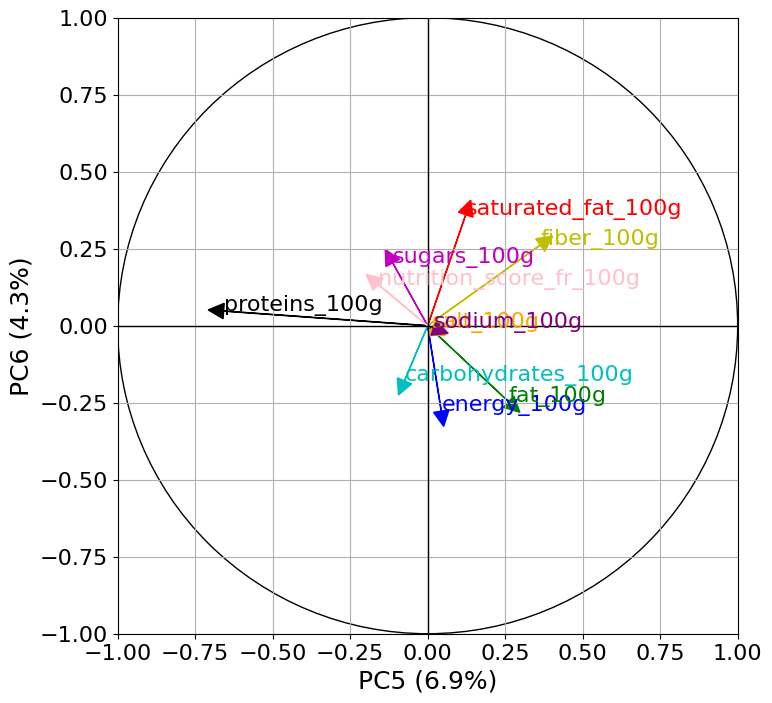

In [109]:
# Assurons-nous que 'pca_5' est l'objet PCA ajusté avec les données 'df_cleaned_scaled'
# pca_5 = PCA(n_components=5).fit(df_cleaned_scaled)
# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_cleaned[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)


# Réappliquer l'ACP avec 5 composantes
pca_6 = PCA(n_components=6)
pca_result_6 = pca_6.fit_transform(df_cleaned_scaled)

# Récupérons les chargements (loadings)
loadings = pca_6.components_.T * np.sqrt(pca_6.explained_variance_)


label_size = 16

# Créons le cercle de corrélation
fig, ax = plt.subplots(figsize=(8, 8))

# Définissons les couleurs pour chaque variable
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'purple', 'pink']

# Ajoutons des flèches et des labels
for i in range(loadings.shape[0]):
    ax.arrow(0, 0, loadings[i, 4], loadings[i, 5], color=colors[i], 
             head_width=0.05, head_length=0.05)
    plt.text(loadings[i, 4], loadings[i, 5], numeric_columns[i], color=colors[i], fontsize=label_size)

# Dessinons le cercle unitaire
circle = plt.Circle((0, 0), 1, color='black', fill=False)
ax.add_artist(circle)

# Définissons les limites des axes
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
plt.xticks(fontsize=label_size)
plt.yticks(fontsize=label_size)

# Afficher le pourcentage de variance expliquée dans les labels des axes
variance_explained_pc1 = pca_6.explained_variance_ratio_[4] * 100  # pour la PC5
variance_explained_pc2 = pca_6.explained_variance_ratio_[5] * 100  # pour la PC6
ax.set_xlabel(f'PC5 ({variance_explained_pc1:.1f}%)', fontsize=label_size+2)
ax.set_ylabel(f'PC6 ({variance_explained_pc2:.1f}%)', fontsize=label_size+2)

# ax.set_title('Cercle de corrélation pour PC5 et PC6')
ax.axhline(0, color='black', lw=1)
ax.axvline(0, color='black', lw=1)

plt.grid()

# Affichons le cercle de corrélation
plt.show()

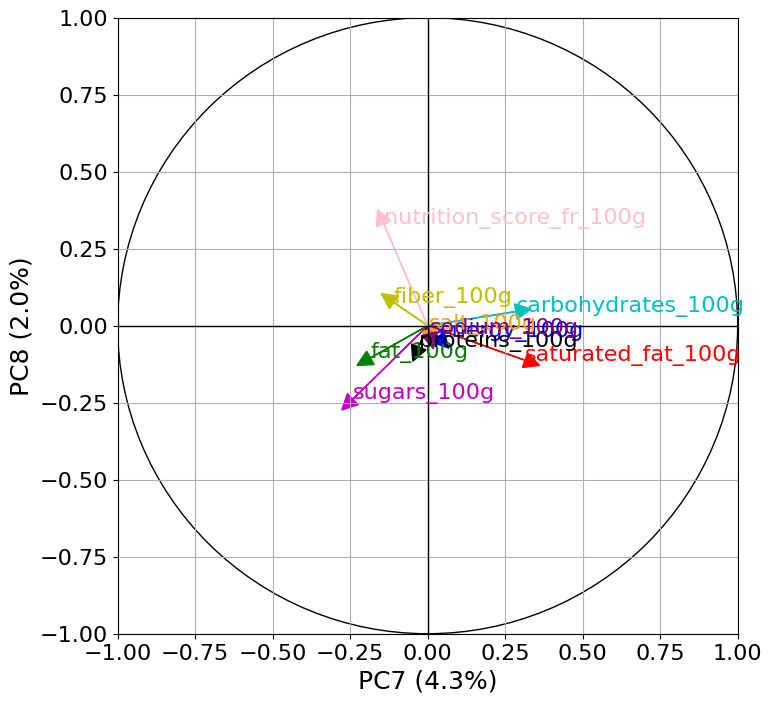

In [120]:
# Assurons-nous que 'pca_5' est l'objet PCA ajusté avec les données 'df_cleaned_scaled'
# pca_5 = PCA(n_components=5).fit(df_cleaned_scaled)
# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_cleaned[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)


# Réappliquer l'ACP avec 5 composantes
pca_6 = PCA(n_components=8)
pca_result_6 = pca_6.fit_transform(df_cleaned_scaled)

# Récupérons les chargements (loadings)
loadings = pca_6.components_.T * np.sqrt(pca_6.explained_variance_)


label_size = 16

# Créons le cercle de corrélation
fig, ax = plt.subplots(figsize=(8, 8))

# Définissons les couleurs pour chaque variable
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'purple', 'pink']

# Ajoutons des flèches et des labels
for i in range(loadings.shape[0]):
    ax.arrow(0, 0, loadings[i, 6], loadings[i, 7], color=colors[i], 
             head_width=0.05, head_length=0.05)
    plt.text(loadings[i, 6], loadings[i, 7], numeric_columns[i], color=colors[i], fontsize=label_size)

# Dessinons le cercle unitaire
circle = plt.Circle((0, 0), 1, color='black', fill=False)
ax.add_artist(circle)

# Définissons les limites des axes
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
plt.xticks(fontsize=label_size)
plt.yticks(fontsize=label_size)

# Afficher le pourcentage de variance expliquée dans les labels des axes
variance_explained_pc1 = pca_6.explained_variance_ratio_[5] * 100  # pour la PC7
variance_explained_pc2 = pca_6.explained_variance_ratio_[7] * 100  # pour la PC8
ax.set_xlabel(f'PC7 ({variance_explained_pc1:.1f}%)', fontsize=label_size+2)
ax.set_ylabel(f'PC8 ({variance_explained_pc2:.1f}%)', fontsize=label_size+2)

# ax.set_title('Cercle de corrélation pour PC5 et PC6')
ax.axhline(0, color='black', lw=1)
ax.axvline(0, color='black', lw=1)

plt.grid()

# Affichons le cercle de corrélation
plt.show()

**Critère de Kaiser :** Indication sur le nombre de composantes à retenir

On montre aussi les composantes des axes principaux.

Nombre de composantes à retenir selon le critère de Kaiser: 4


<Axes: >

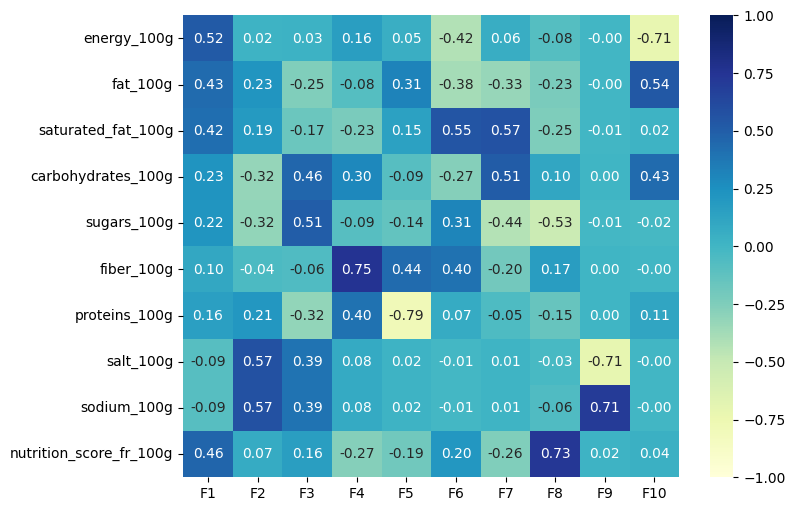

In [119]:
features = df_cleaned_numeric.columns
n_components = 10

# Supposons que df_cleaned_scaled est votre DataFrame standardisé
pca = PCA(n_components=n_components)
pca.fit(df_cleaned_scaled)

x_list = range(1, n_components+1)

# Récupération des valeurs propres
eigenvalues = pca.explained_variance_

# Application du critère de Kaiser
n_components_kaiser = sum(eigenvalues > 1)

print(f"Nombre de composantes à retenir selon le critère de Kaiser: {n_components_kaiser}")

pcs = pca.components_
pcs = pd.DataFrame(pcs)

pcs.columns = features
pcs.index = [f"F{i}" for i in x_list]

fig, ax = plt.subplots(figsize=(8, 6))
sns.heatmap(pcs.T, vmin=-1, vmax=1, annot=True, cmap="YlGnBu", fmt="0.2f")


In [17]:

# Sélection des colonnes numériques pour l'ACP
numeric_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'carbohydrates_100g', 
    'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 
    'sodium_100g', 'nutrition_score_fr_100g'
]
df_cleaned_numeric = df_cleaned[numeric_columns]

# Standardisation des données
scaler = StandardScaler()
df_cleaned_scaled = scaler.fit_transform(df_cleaned_numeric)
# 4) Analyse ANOVA avec le test F et Eta²
# Calculer les scores du premier composant principal

pca_5 = PCA(n_components=5)
pca_result_5 = pca_5.fit_transform(df_cleaned_scaled)
df_cleaned['PCA1'] = pca_result_5[:, 0]

# ANOVA F-test
anova_results = pg.anova(data=df_cleaned, dv='PCA1', between='nutrition_grade_fr', detailed=True)

# Eta-squared test
eta_squared = anova_results['np2']

In [18]:
anova_results

,Source,SS,DF,MS,F,p-unc,np2
0,nutrition_grade_fr,528057.585044,4,132014.396261,117056.678174,0.0,0.642306
1,Within,294070.243376,260751,1.127782,NaN,NaN,NaN


In [19]:
eta_squared

0    0.642306
1         NaN
Name: np2, dtype: float64

In [36]:
# Assurons-nous que df_cleaned['PCA1'] est déjà définie et contient les valeurs du premier composant principal
# et que df_cleaned['nutrition_grade_fr'] contient les grades nutritionnels

# 5) Vérification des conditions d'ANOVA paramétrique

# Test de normalité avec le test de Kolmogorov-Smirnov pour chaque grade nutritionnel
ks_tests = {}
for grade in df_cleaned['nutrition_grade_fr'].unique():
    sample = df_cleaned[df_cleaned['nutrition_grade_fr'] == grade]['PCA1']
    ks_stat, ks_p = stats.kstest(sample, 'norm', alternative='two-sided', mode='asymp')
    ks_tests[grade] = {'KS Statistic': ks_stat, 'p-value': ks_p}

# Test d'homogénéité des variances avec le test de Levene
levene_stat, levene_p = stats.levene(
    *[df_cleaned[df_cleaned['nutrition_grade_fr'] == grade]['PCA1'] for grade in df_cleaned['nutrition_grade_fr'].unique()]
)

# 6) ANOVA non-paramétrique avec le test H de Kruskal-Wallis
kruskal_stat, kruskal_p = stats.kruskal(
    *[df_cleaned[df_cleaned['nutrition_grade_fr'] == grade]['PCA1'] for grade in df_cleaned['nutrition_grade_fr'].unique()]
)

In [42]:
ks_tests, levene_stat, levene_p, kruskal_stat, kruskal_p

({'d': {'KS Statistic': 0.3336870953522746, 'p-value': 0.0},
  'b': {'KS Statistic': 0.6845959704400135, 'p-value': 0.0},
  'a': {'KS Statistic': 0.5704730187299469, 'p-value': 0.0},
  'c': {'KS Statistic': 0.2608439221079616, 'p-value': 0.0},
  'e': {'KS Statistic': 0.7457469937001487, 'p-value': 0.0}},
 3406.3041591391234,
 0.0,
 172992.68426006625,
 0.0)

In [37]:
ks_tests

{'d': {'KS Statistic': 0.3336870953522746, 'p-value': 0.0},
 'b': {'KS Statistic': 0.6845959704400135, 'p-value': 0.0},
 'a': {'KS Statistic': 0.5704730187299469, 'p-value': 0.0},
 'c': {'KS Statistic': 0.2608439221079616, 'p-value': 0.0},
 'e': {'KS Statistic': 0.7457469937001487, 'p-value': 0.0}}

In [38]:
levene_stat

3406.3041591391234

In [39]:
levene_p

0.0

In [40]:
kruskal_stat

172992.68426006625

In [41]:
kruskal_p

0.0

## QUESTIONS

- Que faire de tous les outliers dans les boxplots du NB1 ?
- Dois-je calculer des coefficients de corrélation ?
- Quel est le message principal que je dois donner a la soutenance ?
- "KNeighbourClassifier pour nutrition_grades en faisan le learning curve afin de trouver le bon nombre des voisins." --> J'ai fait un calcul direct, c'est ok?